<a href="https://www.kaggle.com/code/bhuvaneshsingla/gan-v10-trial1?scriptVersionId=160579696" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
from PIL import Image

#/kaggle/input/procedural-environment-generation/dataset/kaggle/working/dataset

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
dir_data = "/kaggle/input/procedural-environment-generation/dataset/dataset"
img_shape = (256,256,1)
img_paths = [dir_data + '/' + file for file in os.listdir(dir_data)]
img_paths = img_paths[:-6]

In [3]:
img_paths = np.sort(img_paths)

In [4]:
def load_images(img_paths):
    for image in img_paths:
        img = Image.open(image)
        img_array = np.array(img)
        img_array_normalized = (img_array - np.min(img_array)) / (np.max(img_array) - np.min(img_array))
        
        yield np.transpose(np.expand_dims(np.float32(img_array_normalized), axis = 2),(2,0,1))

In [5]:
import matplotlib.pyplot as plt
import numpy as np
import torch
 
import torch.nn as nn
 
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torch.nn import Module, Sequential, Conv2d, ConvTranspose2d, LeakyReLU, BatchNorm2d, ReLU, Tanh, Sigmoid, BCELoss , AvgPool2d, Linear
 
%matplotlib inline

In [6]:
def plot_images(imgs, grid_size = 5):

    fig = plt.figure(figsize = (9, 9))
    plt.axis("off")
    columns = rows = grid_size
    plt.title("Training Images")
    images = load_images(imgs)
    for i in range(1, columns*rows +1):
        
        fig.add_subplot(rows, columns, i)
        plt.axis("off")
        plt.imshow(np.transpose(next(images), (1,2,0)), cmap = 'gray')
        
    plt.show()

In [7]:
dev = 'cuda:0' if torch.cuda.is_available() == True else 'cpu'
device = torch.device(dev)

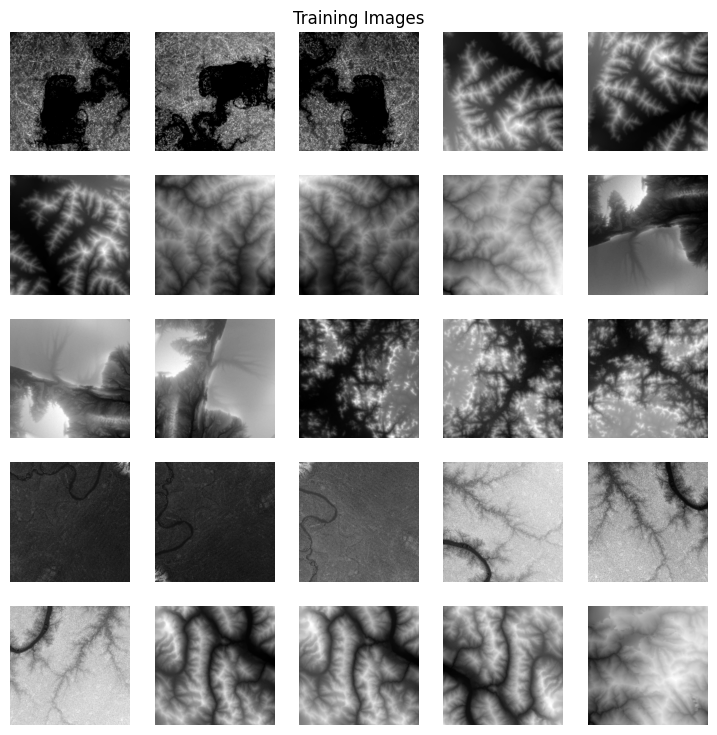

In [8]:
plot_images(img_paths, 5)

In [9]:
class Terrains(Dataset):
    def __init__(self, img_paths):
        '''np array containing all paths to all images'''
        self.img_paths = img_paths
    
    def __len__(self):
        return len(self.img_paths)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        image = next(load_images([self.img_paths[idx]]))
        return image

In [10]:
dset = Terrains(img_paths)
batch_size = 64
shuffle = True

In [11]:
dset

In [12]:
dataloader = DataLoader(dataset = dset, batch_size = batch_size, shuffle = shuffle)

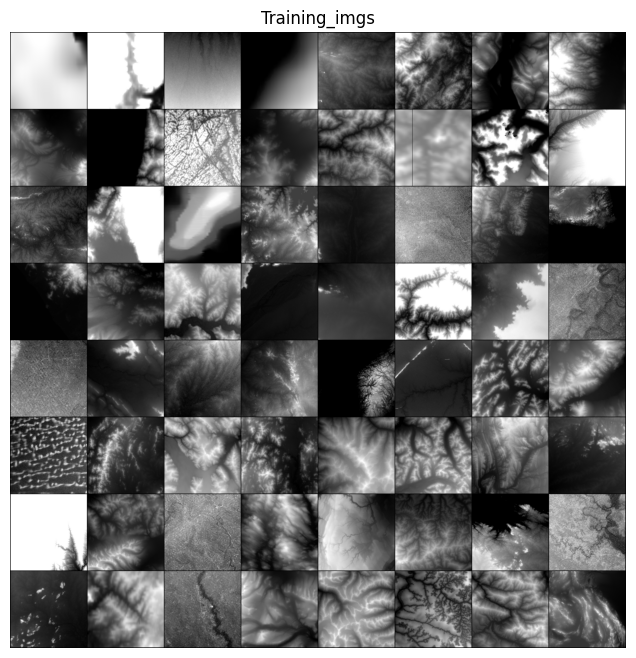

In [13]:
import torchvision.utils as vutils
real_batch = next(iter(dataloader))
plt.figure(figsize = (8,8))
plt.axis("off")
plt.title("Training_imgs")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding = 2, normalize=True).cpu(),(1,2,0)), cmap='gray')
plt.show()

In [14]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [15]:
BATCH_SIZE = 64
D_lr = 3e-6
G_lr = 3e-4
FILTER_SIZE = 8

In [16]:
s = 256
s2, s4, s8 = int(s/2), int(s/4), int(s/8)
g_dim = 64
c_dim = 1

In [17]:
class Generator(Module):
    
    
    def __init__(self, batch_size, reuse = False):
        super().__init__()
               
        
        output2_shape = [batch_size, g_dim, s4 , s4 ]
        self.b_conv2 = nn.Parameter(torch.ones(output2_shape[1]) * 0.1)
        self.resize_layer2 = nn.Upsample(size=(output2_shape[2], output2_shape[3]), mode='nearest')
        self.conv2 = nn.Conv2d(in_channels=g_dim, out_channels=s4, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        self.batch_norm2 = nn.BatchNorm2d(s4)
        
        output3_shape = [batch_size,g_dim*2, s2 , s2 ]
        self.b_conv3 = nn.Parameter(torch.ones(output3_shape[1]) * 0.1)
        self.resize_layer3 = nn.Upsample(size=(output3_shape[2], output3_shape[3]), mode='nearest')
        self.conv3 = nn.Conv2d(in_channels=g_dim, out_channels=s8, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        self.batch_norm3 = nn.BatchNorm2d(s8)
        
        output4_shape = [batch_size, c_dim, s, s]
        self.b_conv4 = nn.Parameter(torch.ones(output4_shape[1]) * 0.1)
        self.resize_layer4 = nn.Upsample(size=(output4_shape[2], output4_shape[3]), mode='nearest')
        self.conv4 = nn.Conv2d(in_channels=s8, out_channels=1, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        
    def forward(self, z):
        h0 = torch.reshape(z, [batch_size, 64,s8,s8])
        h0 = LeakyReLU()(h0)
#         print(h0.shape)
        h_conv2 = self.resize_layer2(h0) + self.b_conv2
#         print(h_conv2.shape)
        h_conv2 = self.conv2(h_conv2)
#         print(h_conv2.shape)
        h_conv2 = LeakyReLU()(h_conv2)
        h_conv2 = self.batch_norm2(h_conv2)
        h_conv2 = LeakyReLU()(h_conv2)
        
        h_conv3 = self.resize_layer3(h_conv2) + self.b_conv3
#         print(h_conv3.shape)
        h_conv3 = self.conv3(h_conv3)
#         print(h_conv3.shape)
        h_conv3 = LeakyReLU()(h_conv3)
        h_conv3 = self.batch_norm3(h_conv3)
        h_conv3 = LeakyReLU()(h_conv3)
        
        h_conv4 = self.resize_layer4(h_conv3) + self.b_conv4
#         print(h_conv4.shape)
        h_conv4 = self.conv4(h_conv4)
#         print(h_conv4.shape)
        h_conv4 = LeakyReLU()(h_conv4)
        h_conv4 = Tanh()(h_conv4)
        
        return h_conv4

In [18]:
class Discriminator(Module):
    def __init__(self):
        super().__init__()
        self.leaky_relu = LeakyReLU()
        #256x256x1
        self.conv1 = Conv2d(in_channels=1, out_channels= 8 , kernel_size = 5, stride = 1, padding=1, bias = False)
        #leaky relu here
        #256x256x8
        self.pool1 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
        #128x128x8
        self.conv2 = Conv2d(in_channels=8, out_channels= 16 , kernel_size = 5, stride = 1, padding=1,  bias = False)
#         LeakyRelu here
        #128x128x16
        self.pool2 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
        #64x64x16
        #add flatten
        self.dimval = 64*64*16
        
        self.fc1 = Linear(self.dimval, 32,  bias = False)
#         LeakyReLU here
        self.fc2 = Linear(32, 1,  bias = False)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, inputs):
#         print(inputs.shape)
        x = self.conv1(inputs)
#         print(x.shape)
        x = self.leaky_relu(x)
#         print(x.shape)
        x = self.pool1(x)
#         print(x.shape)
        x = self.conv2(x)
#         print(x.shape)
        x = self.leaky_relu(x)
#         print(x.shape)
        x = self.pool2(x)
#         print(x.shape)
        
        x = torch.reshape(x, [x.shape[0], self.dimval])
        
        x = self.fc1(x)
        x = self.leaky_relu(x)
        
        x =  self.fc2(x)
        output = self.sigmoid(x)
        return output

In [19]:
ngpu = 1

In [20]:
# Create the generator
netG = Generator(BATCH_SIZE).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (resize_layer2): Upsample(size=(64, 64), mode='nearest')
  (conv2): Conv2d(64, 64, kernel_size=(8, 8), stride=(1, 1), padding=same)
  (batch_norm2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (resize_layer3): Upsample(size=(128, 128), mode='nearest')
  (conv3): Conv2d(64, 32, kernel_size=(8, 8), stride=(1, 1), padding=same)
  (batch_norm3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (resize_layer4): Upsample(size=(256, 256), mode='nearest')
  (conv4): Conv2d(32, 1, kernel_size=(8, 8), stride=(1, 1), padding=same)
)


In [21]:
netD = Discriminator().to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (leaky_relu): LeakyReLU(negative_slope=0.01)
  (conv1): Conv2d(1, 8, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (pool1): AvgPool2d(kernel_size=2, stride=2, padding=1)
  (conv2): Conv2d(8, 16, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (pool2): AvgPool2d(kernel_size=2, stride=2, padding=1)
  (fc1): Linear(in_features=65536, out_features=32, bias=False)
  (fc2): Linear(in_features=32, out_features=1, bias=False)
  (sigmoid): Sigmoid()
)


In [22]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(batch_size, 256*256, 1,1,device = device)

In [23]:
real_label = 1
fake_label = 0

In [24]:
workers = 2
num_epochs = 20
lr = 0.0002
beta1 = 0.5

In [25]:
optimizerD = optim.Adam(netD.parameters(), lr = D_lr, betas = (beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr = G_lr, betas = (beta1, 0.999))

In [26]:
device

device(type='cuda', index=0)

In [27]:
!mkdir checkpoints

Starting Training Loop...


/opt/conda/lib/python3.10/site-packages/torch/nn/modules/conv.py:459: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/Convolution.cpp:1003.)
  return F.conv2d(input, weight, bias, self.stride,


[0/20][0/1319]	Loss_D: 1.3864	Loss_G: 0.6932	D(x): 0.4999	D(G(z)): 0.4999 / 0.5000


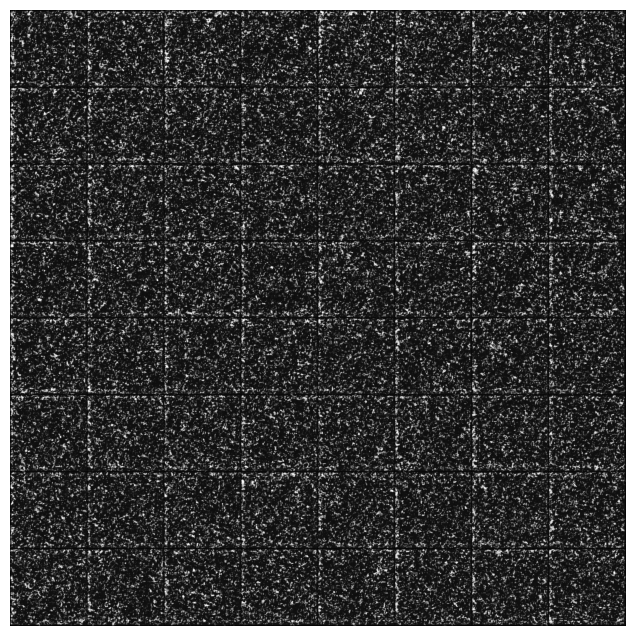

[0/20][50/1319]	Loss_D: 1.3834	Loss_G: 0.7005	D(x): 0.4979	D(G(z)): 0.4965 / 0.4963
[0/20][100/1319]	Loss_D: 1.3891	Loss_G: 0.6946	D(x): 0.4979	D(G(z)): 0.4993 / 0.4993


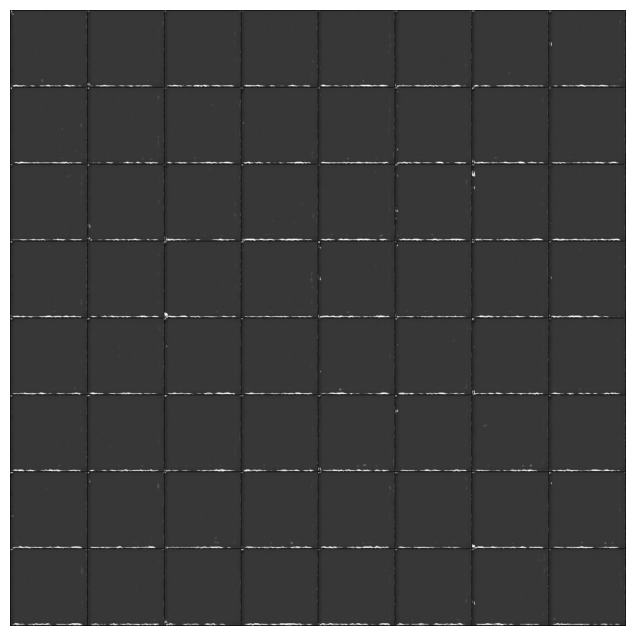

[0/20][150/1319]	Loss_D: 1.3846	Loss_G: 0.6912	D(x): 0.5017	D(G(z)): 0.5008 / 0.5009
[0/20][200/1319]	Loss_D: 1.3911	Loss_G: 0.6899	D(x): 0.5011	D(G(z)): 0.5035 / 0.5016


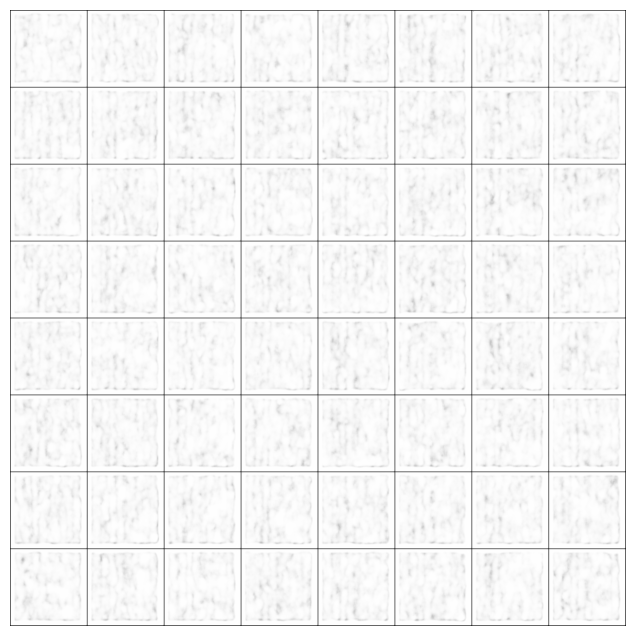

[0/20][250/1319]	Loss_D: 1.3891	Loss_G: 0.6826	D(x): 0.5042	D(G(z)): 0.5055 / 0.5053
[0/20][300/1319]	Loss_D: 1.3854	Loss_G: 0.6927	D(x): 0.5006	D(G(z)): 0.5002 / 0.5002


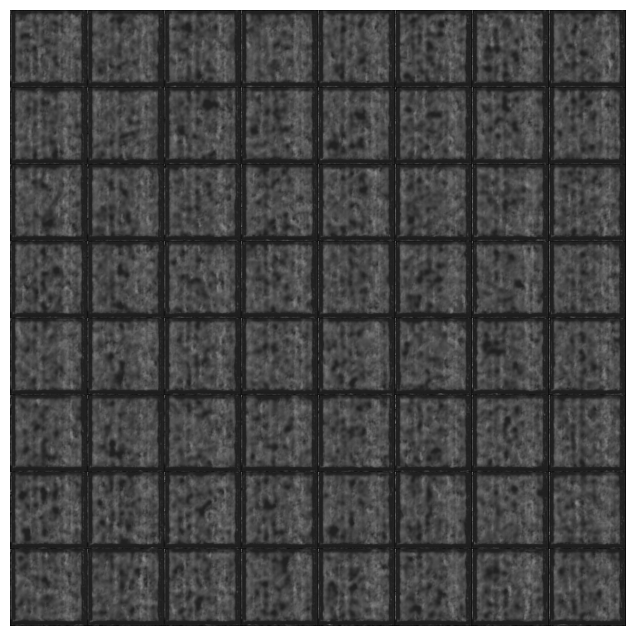

[0/20][350/1319]	Loss_D: 1.3865	Loss_G: 0.6928	D(x): 0.5007	D(G(z)): 0.5007 / 0.5002
[0/20][400/1319]	Loss_D: 1.3773	Loss_G: 0.7114	D(x): 0.4964	D(G(z)): 0.4919 / 0.4910


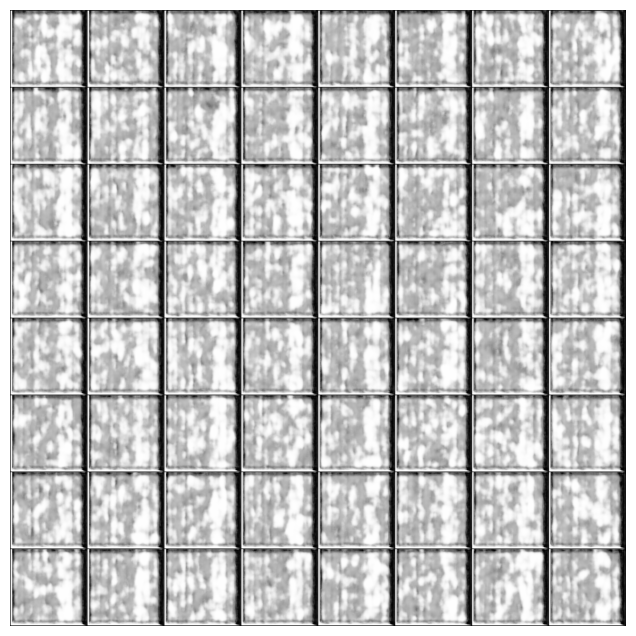

[0/20][450/1319]	Loss_D: 1.3822	Loss_G: 0.7078	D(x): 0.4954	D(G(z)): 0.4932 / 0.4927
[0/20][500/1319]	Loss_D: 1.3854	Loss_G: 0.6929	D(x): 0.5005	D(G(z)): 0.5000 / 0.5001


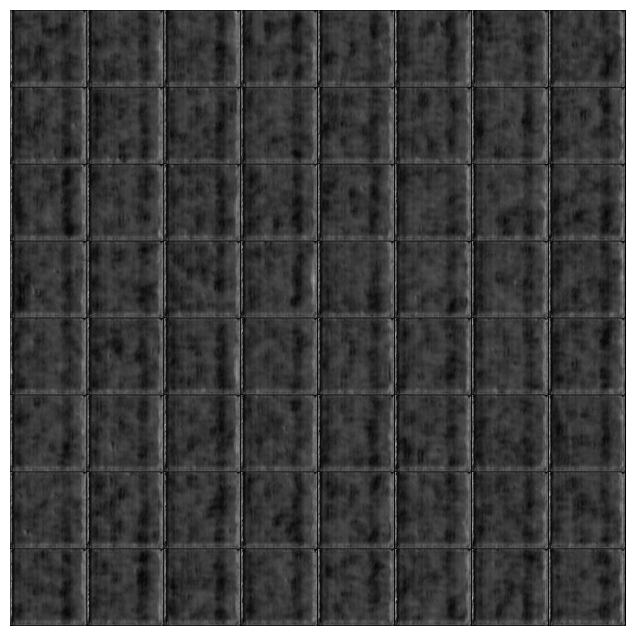

[0/20][550/1319]	Loss_D: 1.3875	Loss_G: 0.6896	D(x): 0.5014	D(G(z)): 0.5020 / 0.5018
[0/20][600/1319]	Loss_D: 1.3840	Loss_G: 0.7018	D(x): 0.4970	D(G(z)): 0.4959 / 0.4957


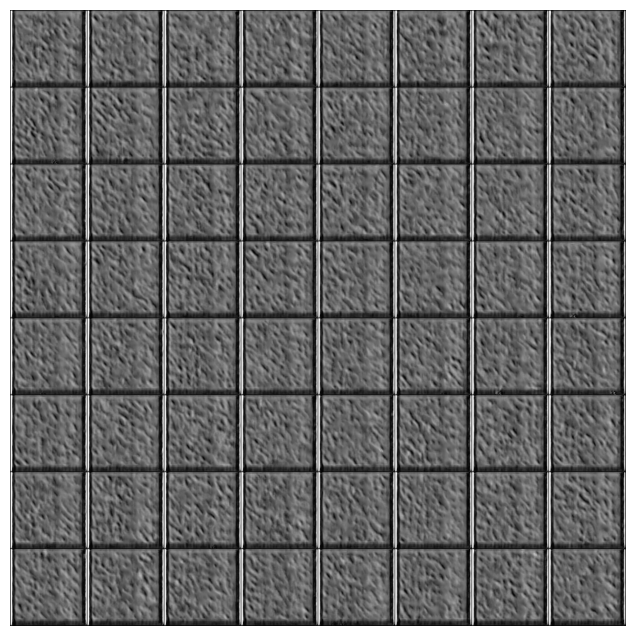

[0/20][650/1319]	Loss_D: 1.3760	Loss_G: 0.7178	D(x): 0.4938	D(G(z)): 0.4885 / 0.4878
[0/20][700/1319]	Loss_D: 1.3936	Loss_G: 0.6840	D(x): 0.5028	D(G(z)): 0.5065 / 0.5046


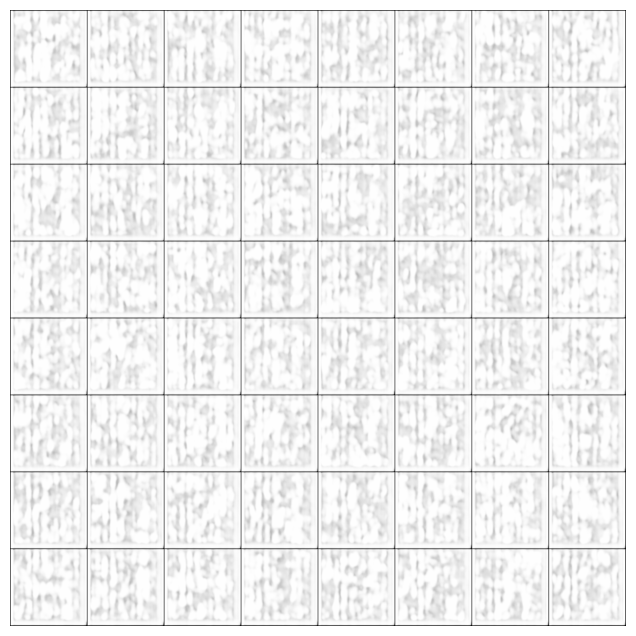

[0/20][750/1319]	Loss_D: 1.3849	Loss_G: 0.6941	D(x): 0.5002	D(G(z)): 0.4995 / 0.4995
[0/20][800/1319]	Loss_D: 1.3988	Loss_G: 0.6977	D(x): 0.4916	D(G(z)): 0.4977 / 0.4977


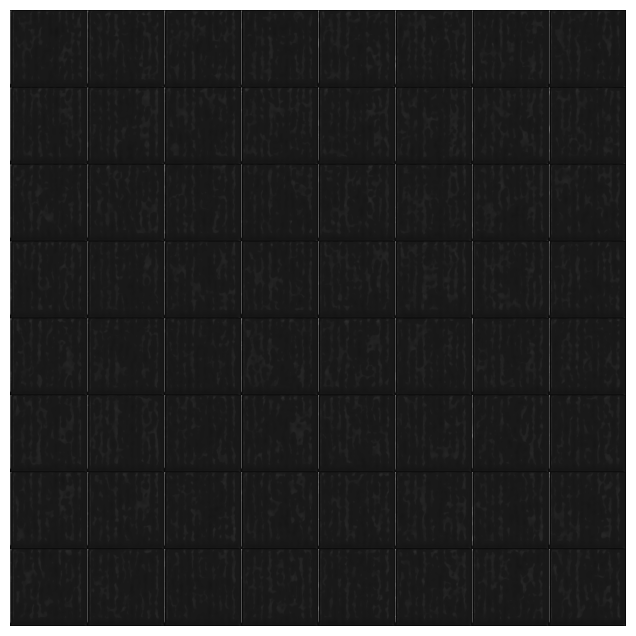

[0/20][850/1319]	Loss_D: 1.3865	Loss_G: 0.6951	D(x): 0.5003	D(G(z)): 0.5004 / 0.4990
[0/20][900/1319]	Loss_D: 1.3720	Loss_G: 0.6947	D(x): 0.5064	D(G(z)): 0.4992 / 0.4992


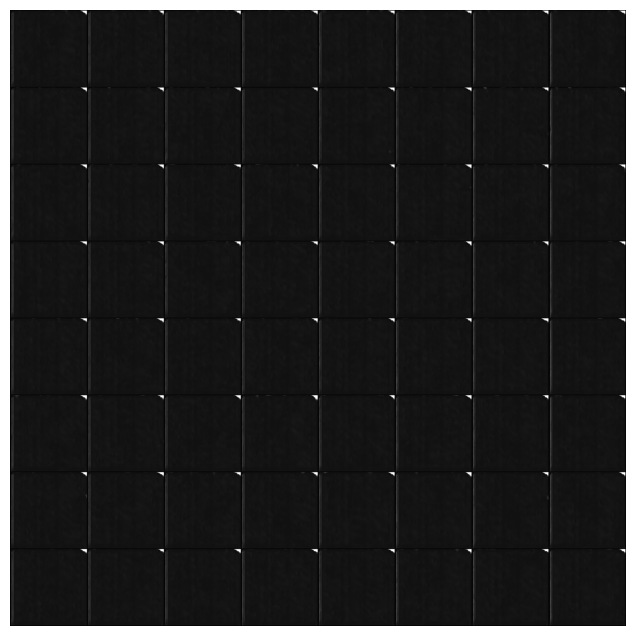

[0/20][950/1319]	Loss_D: 1.3860	Loss_G: 0.7000	D(x): 0.4968	D(G(z)): 0.4966 / 0.4966
[0/20][1000/1319]	Loss_D: 1.3851	Loss_G: 0.7023	D(x): 0.4962	D(G(z)): 0.4956 / 0.4955


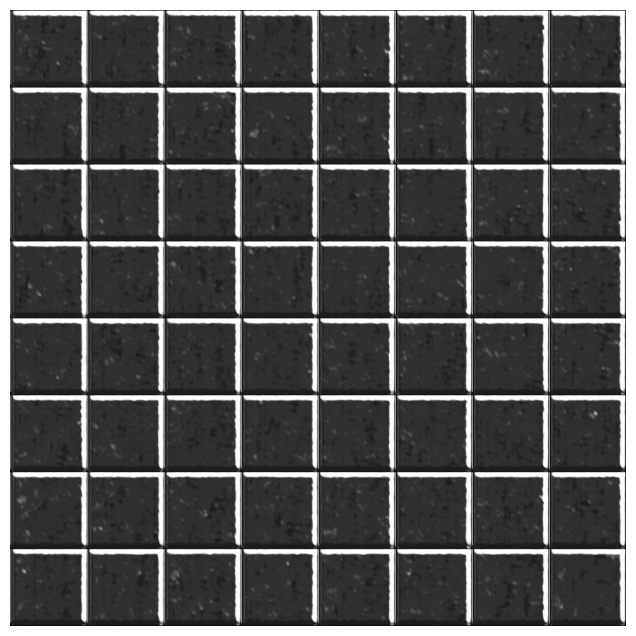

[0/20][1050/1319]	Loss_D: 1.3846	Loss_G: 0.6991	D(x): 0.4979	D(G(z)): 0.4971 / 0.4970
[0/20][1100/1319]	Loss_D: 1.3838	Loss_G: 0.6988	D(x): 0.4984	D(G(z)): 0.4972 / 0.4972


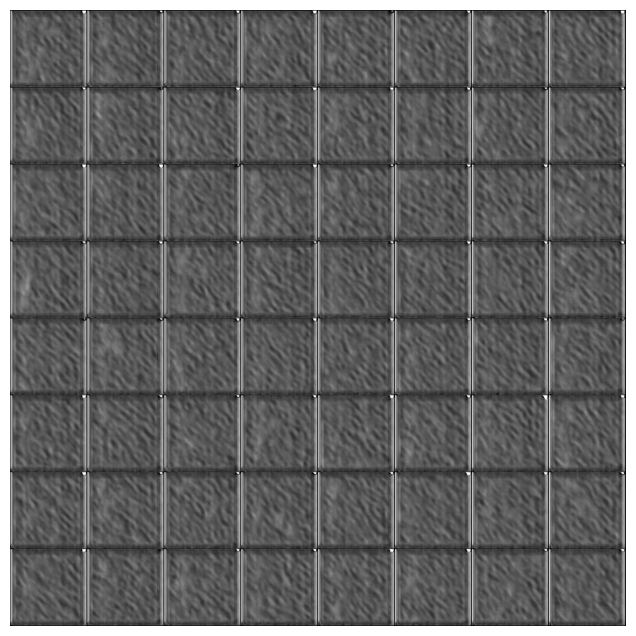

[0/20][1150/1319]	Loss_D: 1.3839	Loss_G: 0.7008	D(x): 0.4977	D(G(z)): 0.4964 / 0.4962
[0/20][1200/1319]	Loss_D: 1.3852	Loss_G: 0.6938	D(x): 0.5004	D(G(z)): 0.4999 / 0.4997


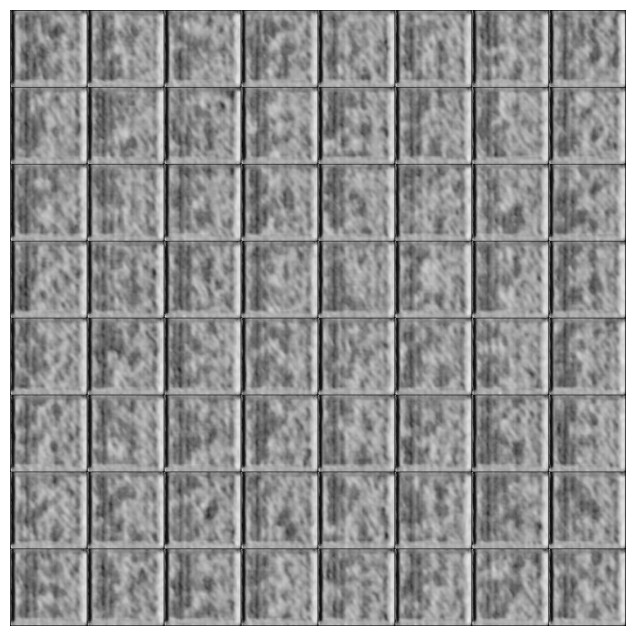

[0/20][1250/1319]	Loss_D: 1.3830	Loss_G: 0.7016	D(x): 0.4978	D(G(z)): 0.4961 / 0.4958
[0/20][1300/1319]	Loss_D: 1.3825	Loss_G: 0.6971	D(x): 0.4999	D(G(z)): 0.4980 / 0.4980


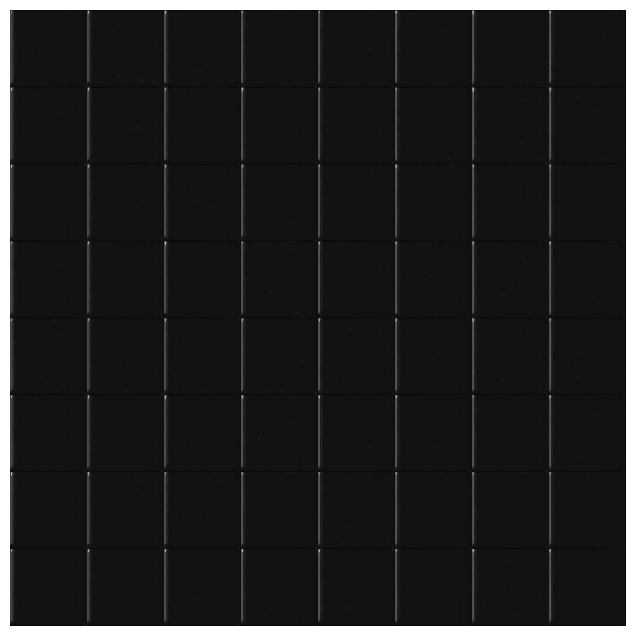

[1/20][0/1319]	Loss_D: 1.3647	Loss_G: 0.6961	D(x): 0.5094	D(G(z)): 0.4985 / 0.4985
[1/20][50/1319]	Loss_D: 1.3944	Loss_G: 0.7035	D(x): 0.4910	D(G(z)): 0.4950 / 0.4948
[1/20][100/1319]	Loss_D: 1.3867	Loss_G: 0.6979	D(x): 0.4974	D(G(z)): 0.4976 / 0.4976
[1/20][150/1319]	Loss_D: 1.3862	Loss_G: 0.6974	D(x): 0.4979	D(G(z)): 0.4979 / 0.4979
[1/20][200/1319]	Loss_D: 1.3860	Loss_G: 0.6979	D(x): 0.4979	D(G(z)): 0.4977 / 0.4976
[1/20][250/1319]	Loss_D: 1.3846	Loss_G: 0.6991	D(x): 0.4980	D(G(z)): 0.4972 / 0.4970
[1/20][300/1319]	Loss_D: 1.3829	Loss_G: 0.7019	D(x): 0.4976	D(G(z)): 0.4959 / 0.4957
[1/20][350/1319]	Loss_D: 1.3791	Loss_G: 0.7085	D(x): 0.4963	D(G(z)): 0.4927 / 0.4924
[1/20][400/1319]	Loss_D: 1.4007	Loss_G: 0.6740	D(x): 0.5045	D(G(z)): 0.5116 / 0.5097
[1/20][450/1319]	Loss_D: 1.3547	Loss_G: 0.7534	D(x): 0.4881	D(G(z)): 0.4713 / 0.4708
[1/20][500/1319]	Loss_D: 1.4103	Loss_G: 0.6598	D(x): 0.5075	D(G(z)): 0.5190 / 0.5170
[1/20][550/1319]	Loss_D: 1.3911	Loss_G: 0.6926	D(x): 0.4981	D(G(z)):

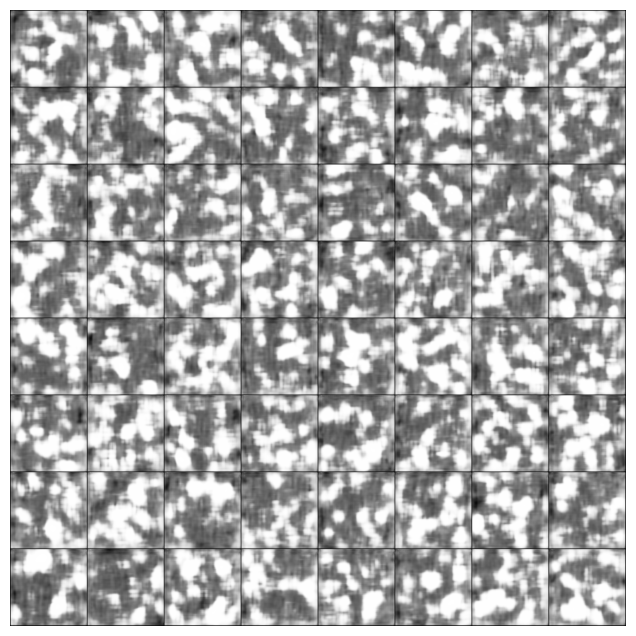

[4/20][50/1319]	Loss_D: 1.3638	Loss_G: 0.7313	D(x): 0.4975	D(G(z)): 0.4859 / 0.4813
[4/20][100/1319]	Loss_D: 1.3605	Loss_G: 0.7645	D(x): 0.4819	D(G(z)): 0.4674 / 0.4656


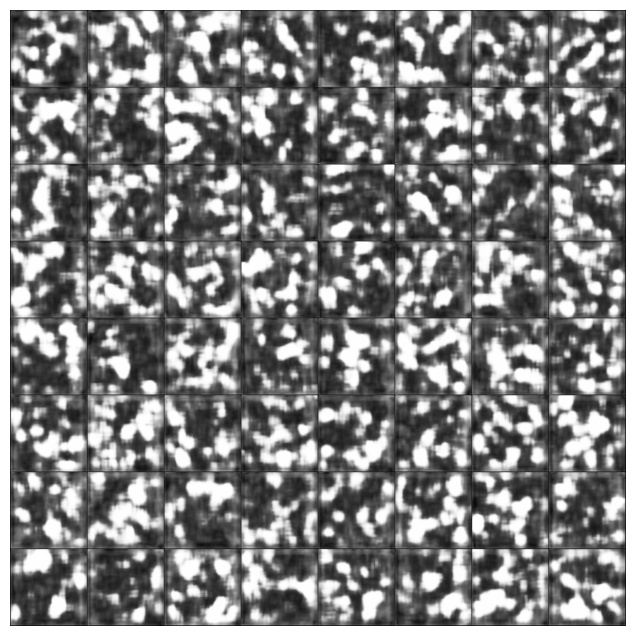

[4/20][150/1319]	Loss_D: 1.3647	Loss_G: 0.7496	D(x): 0.4855	D(G(z)): 0.4737 / 0.4726
[4/20][200/1319]	Loss_D: 1.3797	Loss_G: 0.7202	D(x): 0.4900	D(G(z)): 0.4862 / 0.4867


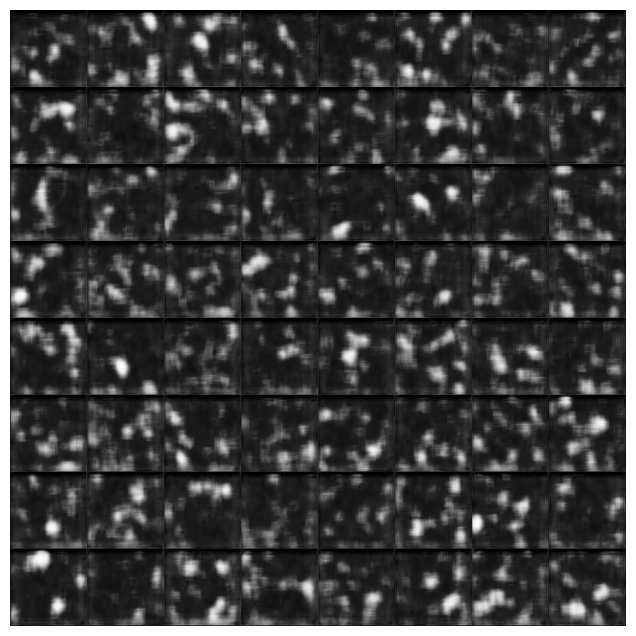

[4/20][250/1319]	Loss_D: 1.3743	Loss_G: 0.6954	D(x): 0.5047	D(G(z)): 0.4985 / 0.4989
[4/20][300/1319]	Loss_D: 1.3755	Loss_G: 0.6682	D(x): 0.5191	D(G(z)): 0.5130 / 0.5127


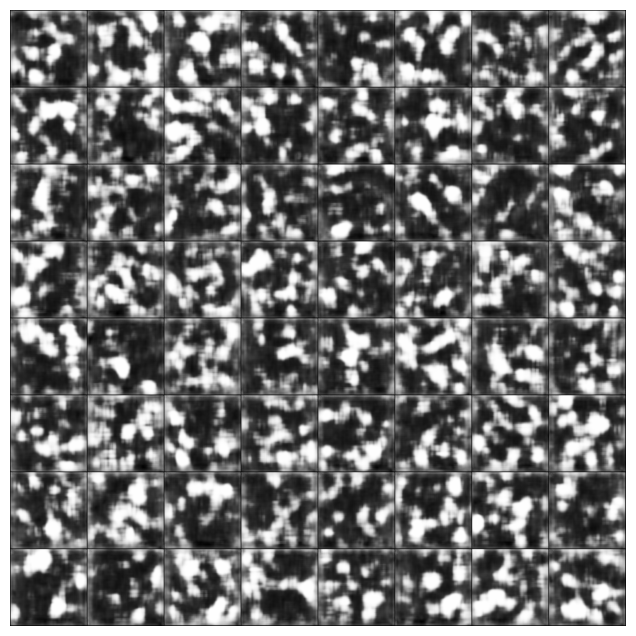

[4/20][350/1319]	Loss_D: 1.3749	Loss_G: 0.7132	D(x): 0.5044	D(G(z)): 0.4985 / 0.4901
[4/20][400/1319]	Loss_D: 1.3529	Loss_G: 0.7866	D(x): 0.4773	D(G(z)): 0.4582 / 0.4554


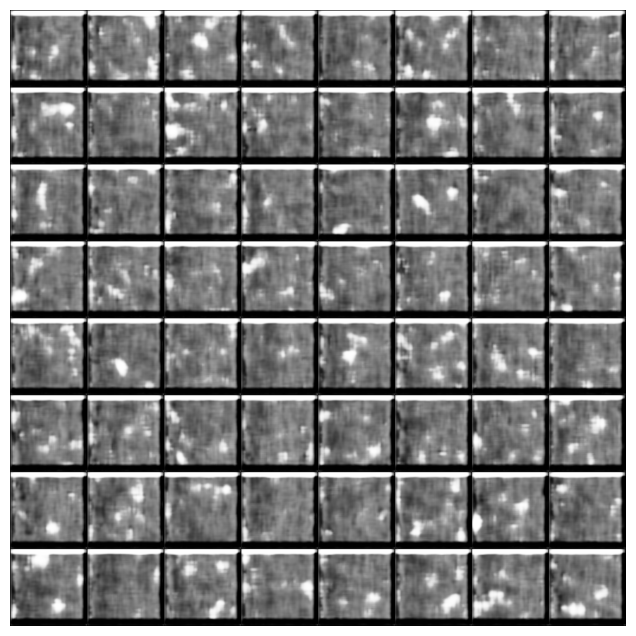

[4/20][450/1319]	Loss_D: 1.3763	Loss_G: 0.7183	D(x): 0.4933	D(G(z)): 0.4880 / 0.4876
[4/20][500/1319]	Loss_D: 1.3627	Loss_G: 0.7022	D(x): 0.5088	D(G(z)): 0.4967 / 0.4955


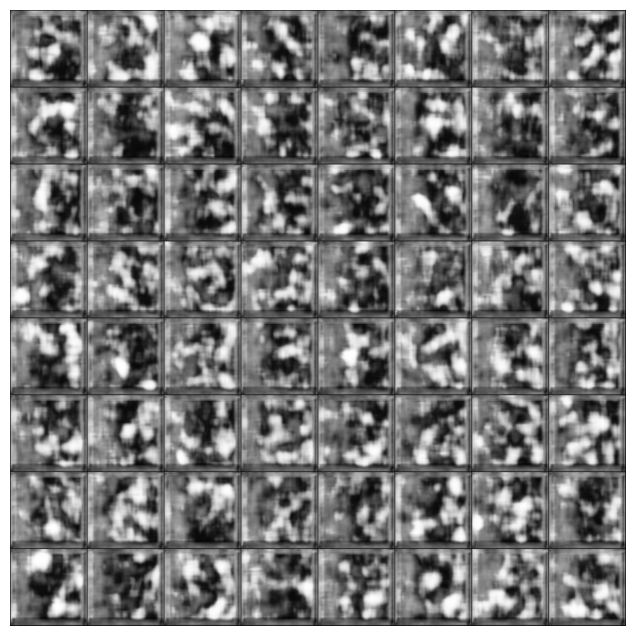

[4/20][550/1319]	Loss_D: 1.3675	Loss_G: 0.6918	D(x): 0.5098	D(G(z)): 0.5001 / 0.5007
[4/20][600/1319]	Loss_D: 1.3764	Loss_G: 0.6946	D(x): 0.5046	D(G(z)): 0.4995 / 0.4993


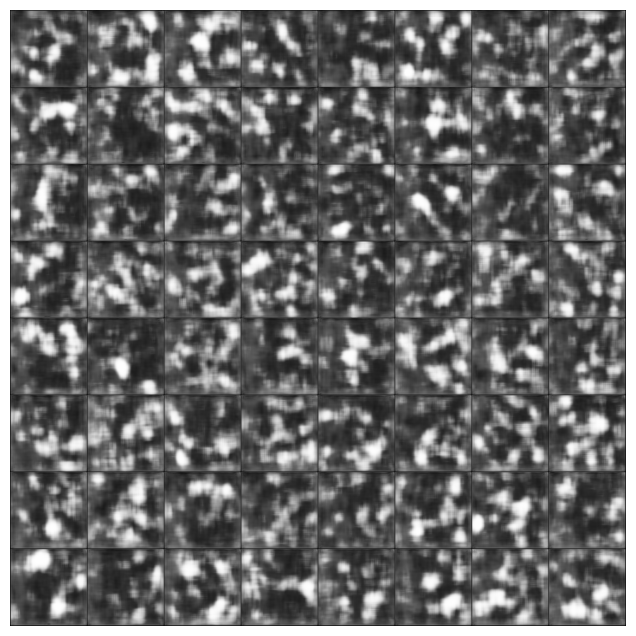

[4/20][650/1319]	Loss_D: 1.3686	Loss_G: 0.6899	D(x): 0.5108	D(G(z)): 0.5016 / 0.5017
[4/20][700/1319]	Loss_D: 1.3717	Loss_G: 0.6958	D(x): 0.5061	D(G(z)): 0.4986 / 0.4987


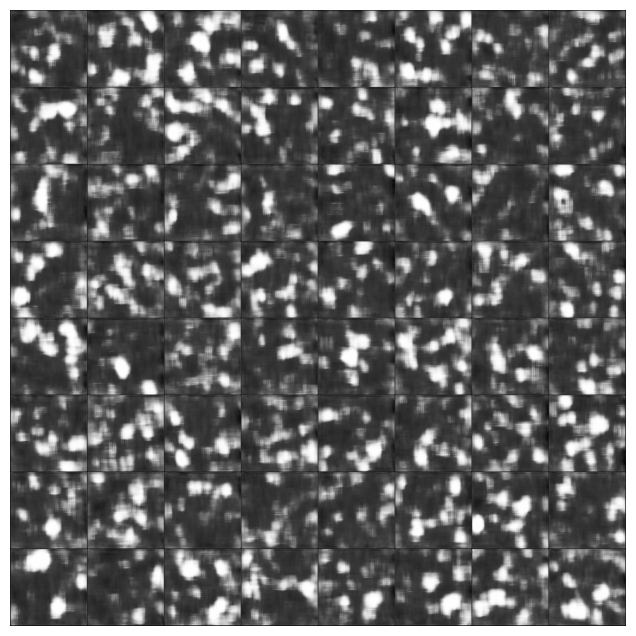

[4/20][750/1319]	Loss_D: 1.3756	Loss_G: 0.6876	D(x): 0.5084	D(G(z)): 0.5027 / 0.5028
[4/20][800/1319]	Loss_D: 1.3667	Loss_G: 0.6935	D(x): 0.5096	D(G(z)): 0.4995 / 0.4999


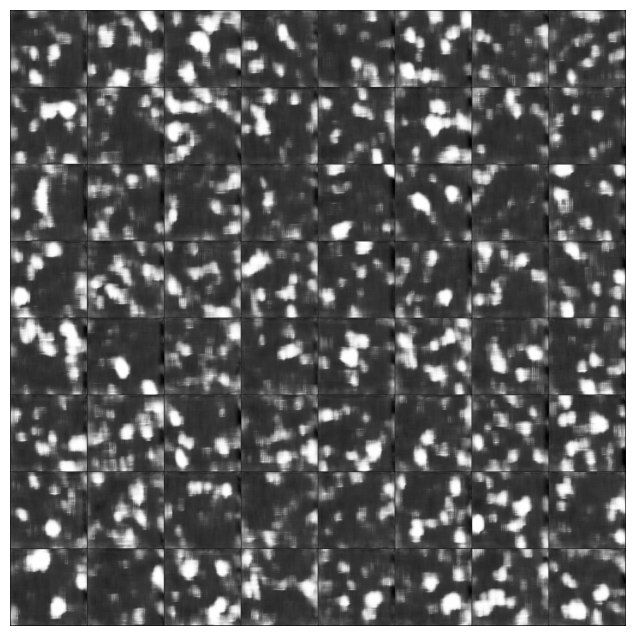

[4/20][850/1319]	Loss_D: 1.3617	Loss_G: 0.6979	D(x): 0.5099	D(G(z)): 0.4972 / 0.4977
[4/20][900/1319]	Loss_D: 1.3672	Loss_G: 0.6984	D(x): 0.5070	D(G(z)): 0.4970 / 0.4974


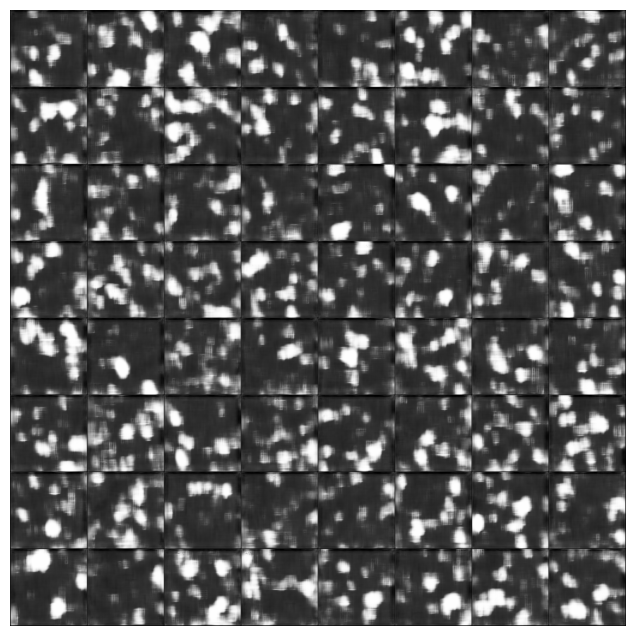

[4/20][950/1319]	Loss_D: 1.3696	Loss_G: 0.6907	D(x): 0.5094	D(G(z)): 0.5007 / 0.5013
[4/20][1000/1319]	Loss_D: 1.3591	Loss_G: 0.6895	D(x): 0.5158	D(G(z)): 0.5016 / 0.5019


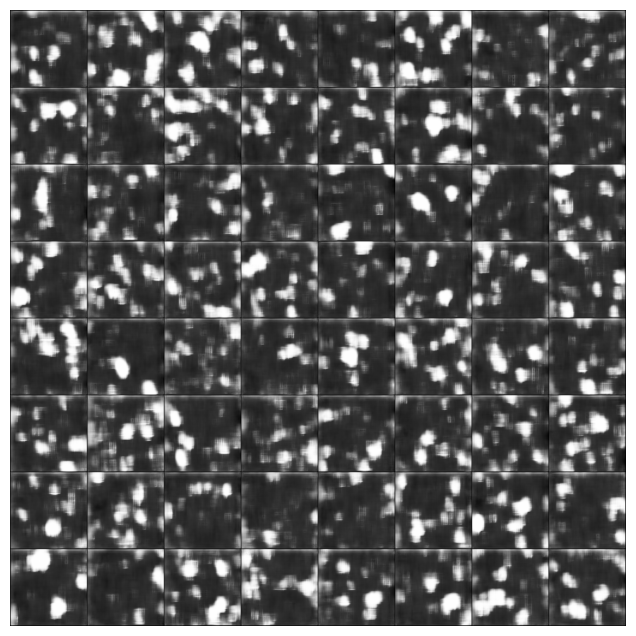

[4/20][1050/1319]	Loss_D: 1.3618	Loss_G: 0.6940	D(x): 0.5141	D(G(z)): 0.5014 / 0.4997
[4/20][1100/1319]	Loss_D: 1.3588	Loss_G: 0.7108	D(x): 0.5048	D(G(z)): 0.4905 / 0.4913


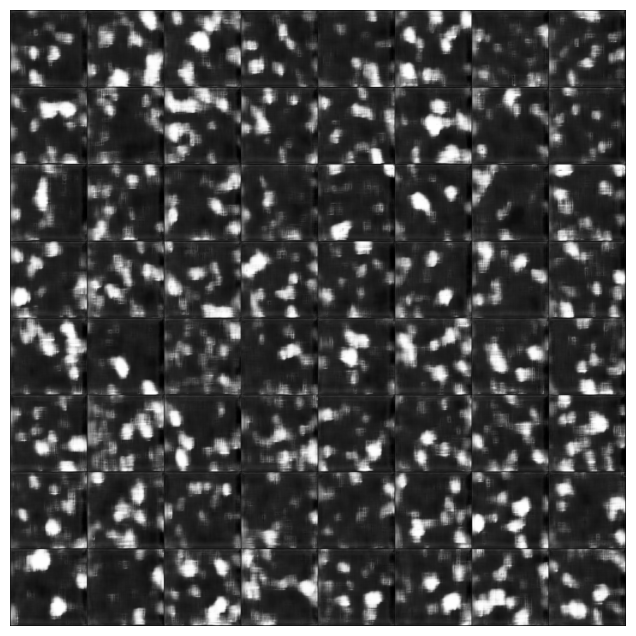

[4/20][1150/1319]	Loss_D: 1.3642	Loss_G: 0.7026	D(x): 0.5051	D(G(z)): 0.4936 / 0.4954
[4/20][1200/1319]	Loss_D: 1.3705	Loss_G: 0.7072	D(x): 0.4998	D(G(z)): 0.4912 / 0.4931


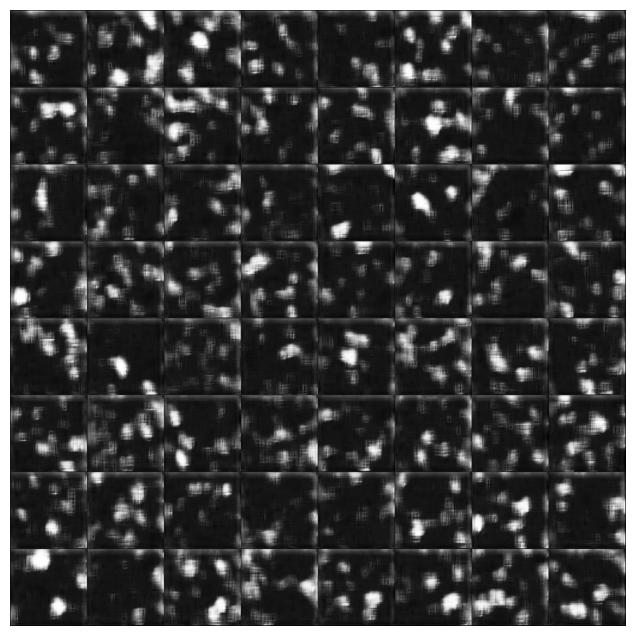

[4/20][1250/1319]	Loss_D: 1.3472	Loss_G: 0.7257	D(x): 0.5062	D(G(z)): 0.4857 / 0.4841
[4/20][1300/1319]	Loss_D: 1.3523	Loss_G: 0.7106	D(x): 0.5125	D(G(z)): 0.4949 / 0.4915


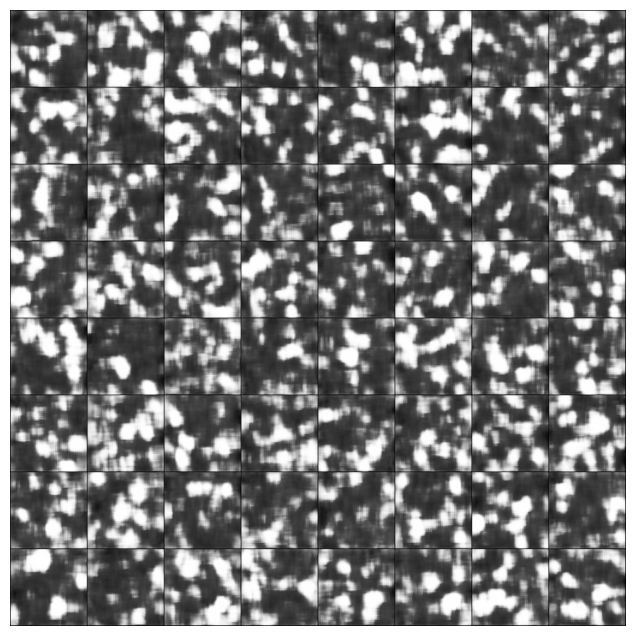

[5/20][0/1319]	Loss_D: 1.3578	Loss_G: 0.6707	D(x): 0.5284	D(G(z)): 0.5122 / 0.5115
[5/20][50/1319]	Loss_D: 1.3623	Loss_G: 0.6724	D(x): 0.5262	D(G(z)): 0.5129 / 0.5106
[5/20][100/1319]	Loss_D: 1.3623	Loss_G: 0.6733	D(x): 0.5267	D(G(z)): 0.5129 / 0.5102
[5/20][150/1319]	Loss_D: 1.3509	Loss_G: 0.6805	D(x): 0.5282	D(G(z)): 0.5088 / 0.5066
[5/20][200/1319]	Loss_D: 1.3487	Loss_G: 0.6951	D(x): 0.5209	D(G(z)): 0.5005 / 0.4994
[5/20][250/1319]	Loss_D: 1.3532	Loss_G: 0.6852	D(x): 0.5190	D(G(z)): 0.5011 / 0.5041
[5/20][300/1319]	Loss_D: 1.3444	Loss_G: 0.6665	D(x): 0.5351	D(G(z)): 0.5117 / 0.5137
[5/20][350/1319]	Loss_D: 1.3469	Loss_G: 0.6728	D(x): 0.5354	D(G(z)): 0.5129 / 0.5106
[5/20][400/1319]	Loss_D: 1.3351	Loss_G: 0.7016	D(x): 0.5259	D(G(z)): 0.4982 / 0.4961
[5/20][450/1319]	Loss_D: 1.3230	Loss_G: 0.6748	D(x): 0.5424	D(G(z)): 0.5078 / 0.5094
[5/20][500/1319]	Loss_D: 1.4496	Loss_G: 0.7087	D(x): 0.4763	D(G(z)): 0.5060 / 0.4923
[5/20][550/1319]	Loss_D: 1.3515	Loss_G: 0.6945	D(x): 0.5225	D(G(z)):

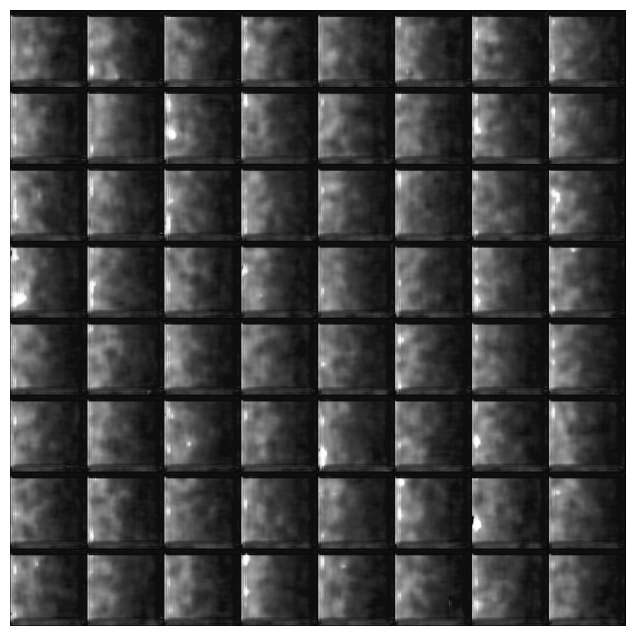

[8/20][50/1319]	Loss_D: 1.1007	Loss_G: 0.6868	D(x): 0.6861	D(G(z)): 0.5051 / 0.5032
[8/20][100/1319]	Loss_D: 1.1494	Loss_G: 0.6767	D(x): 0.6702	D(G(z)): 0.5160 / 0.5088


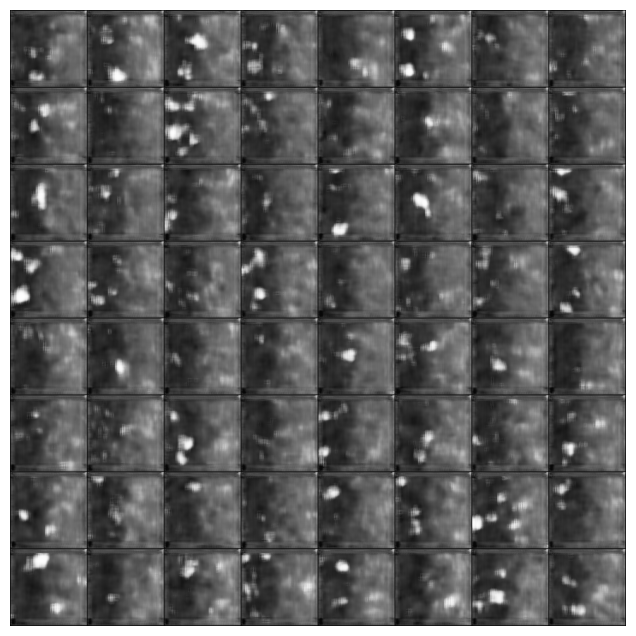

[8/20][150/1319]	Loss_D: 1.2182	Loss_G: 0.6901	D(x): 0.6233	D(G(z)): 0.5058 / 0.5046
[8/20][200/1319]	Loss_D: 1.1971	Loss_G: 0.6692	D(x): 0.6409	D(G(z)): 0.5143 / 0.5140


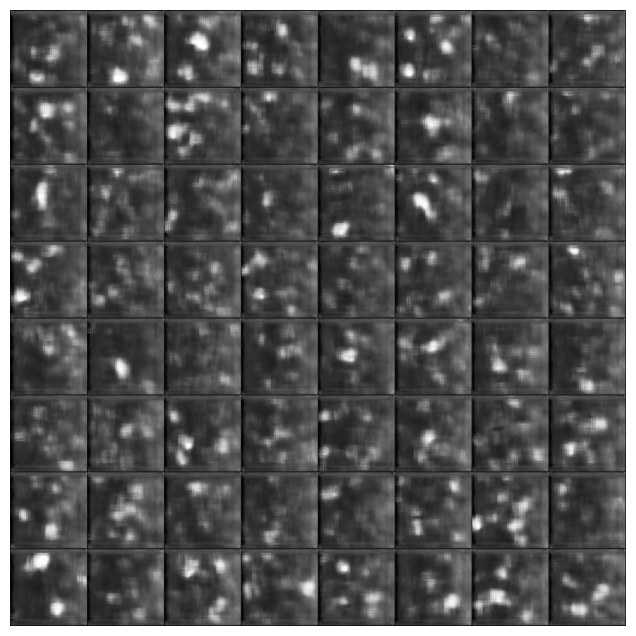

[8/20][250/1319]	Loss_D: 1.2728	Loss_G: 0.6737	D(x): 0.5932	D(G(z)): 0.5113 / 0.5124
[8/20][300/1319]	Loss_D: 1.2284	Loss_G: 0.6895	D(x): 0.6127	D(G(z)): 0.5048 / 0.5043


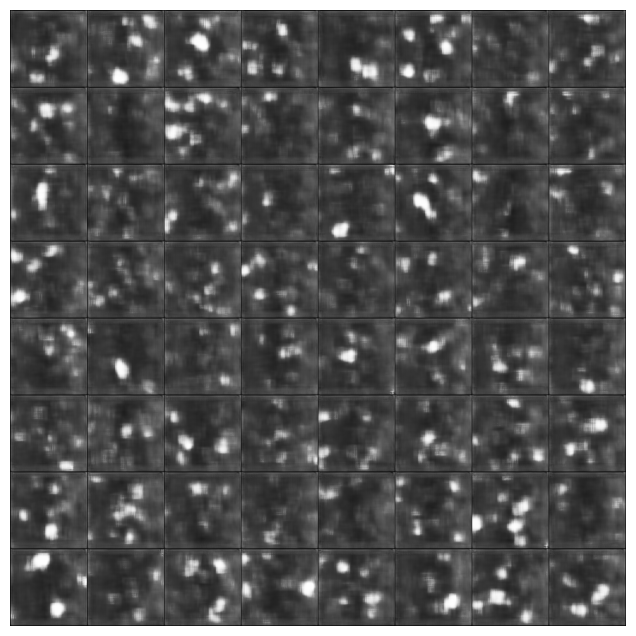

[8/20][350/1319]	Loss_D: 1.1519	Loss_G: 0.6714	D(x): 0.6798	D(G(z)): 0.5155 / 0.5145
[8/20][400/1319]	Loss_D: 1.1654	Loss_G: 0.6780	D(x): 0.6549	D(G(z)): 0.5098 / 0.5096


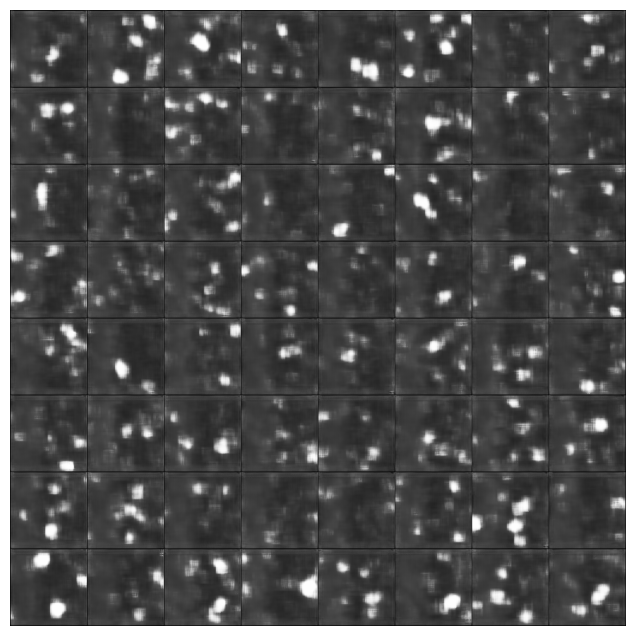

[8/20][450/1319]	Loss_D: 1.1723	Loss_G: 0.6683	D(x): 0.6621	D(G(z)): 0.5162 / 0.5164
[8/20][500/1319]	Loss_D: 1.1491	Loss_G: 0.6738	D(x): 0.6743	D(G(z)): 0.5143 / 0.5137


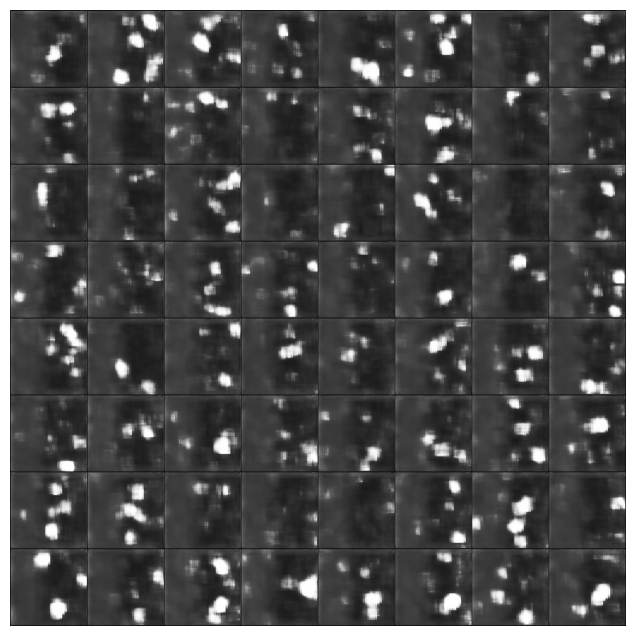

[8/20][550/1319]	Loss_D: 1.2515	Loss_G: 0.6319	D(x): 0.6437	D(G(z)): 0.5343 / 0.5352
[8/20][600/1319]	Loss_D: 1.2448	Loss_G: 0.6419	D(x): 0.6406	D(G(z)): 0.5304 / 0.5309


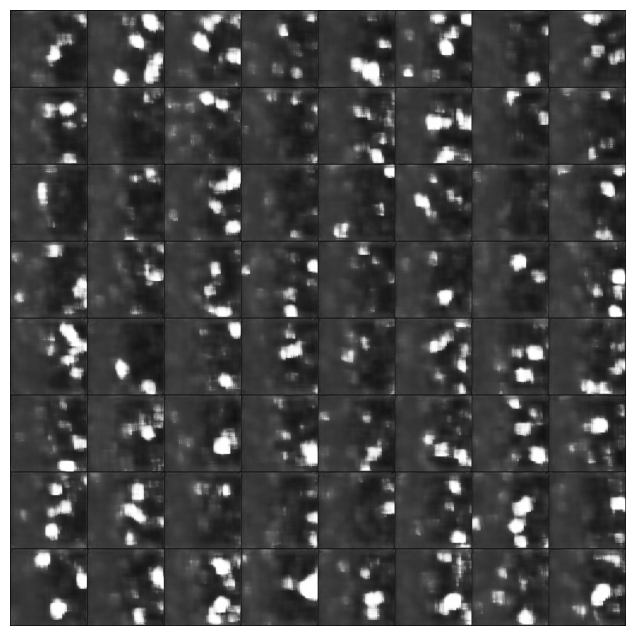

[8/20][650/1319]	Loss_D: 1.2183	Loss_G: 0.6438	D(x): 0.6476	D(G(z)): 0.5285 / 0.5283
[8/20][700/1319]	Loss_D: 1.1570	Loss_G: 0.6778	D(x): 0.6733	D(G(z)): 0.5159 / 0.5126


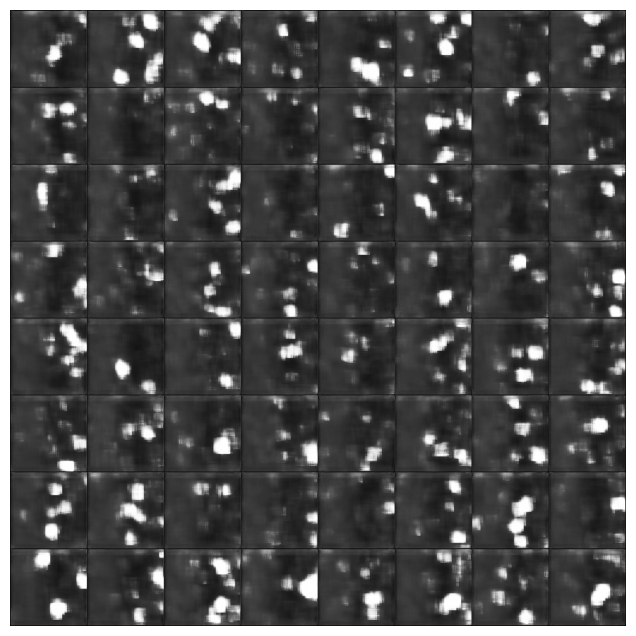

[8/20][750/1319]	Loss_D: 1.1887	Loss_G: 0.6588	D(x): 0.6722	D(G(z)): 0.5269 / 0.5234
[8/20][800/1319]	Loss_D: 1.1681	Loss_G: 0.6674	D(x): 0.6736	D(G(z)): 0.5198 / 0.5181


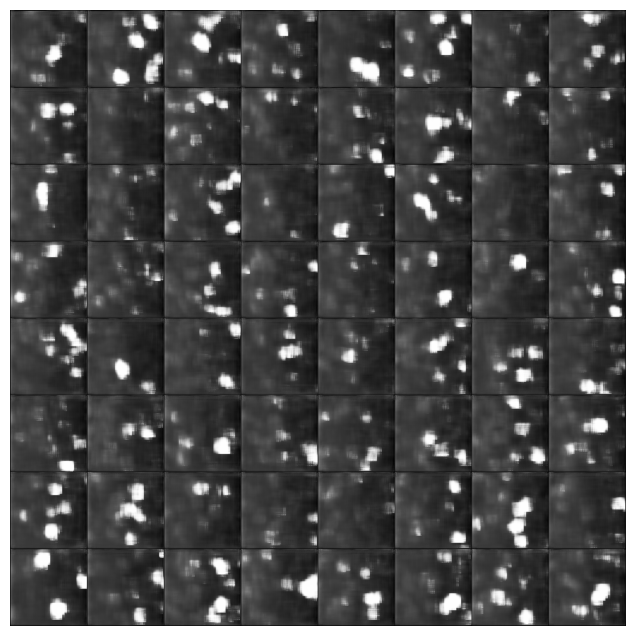

[8/20][850/1319]	Loss_D: 1.1110	Loss_G: 0.7187	D(x): 0.6820	D(G(z)): 0.4960 / 0.4909
[8/20][900/1319]	Loss_D: 1.2447	Loss_G: 0.5184	D(x): 0.7558	D(G(z)): 0.6010 / 0.6017


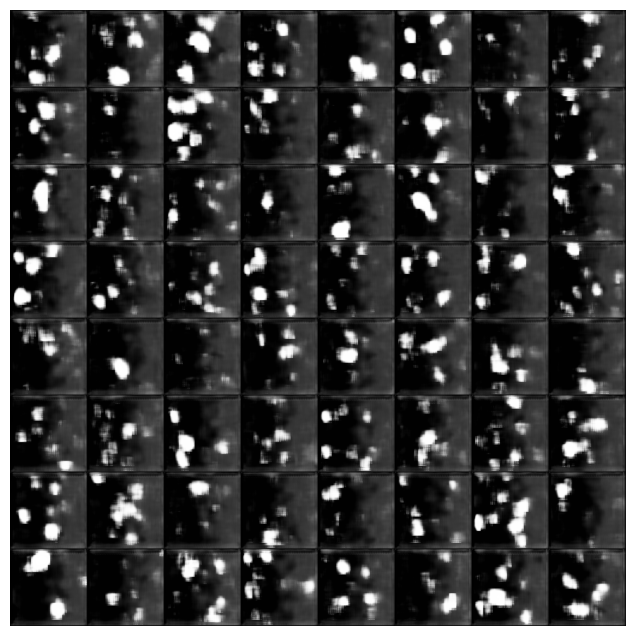

[8/20][950/1319]	Loss_D: 1.2757	Loss_G: 0.4946	D(x): 0.7702	D(G(z)): 0.6238 / 0.6139
[8/20][1000/1319]	Loss_D: 1.1386	Loss_G: 0.7431	D(x): 0.6513	D(G(z)): 0.4947 / 0.4778


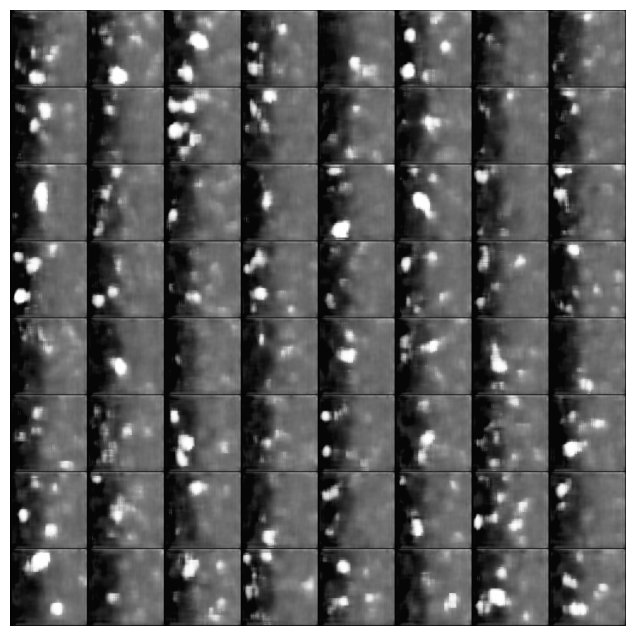

[8/20][1050/1319]	Loss_D: 1.1091	Loss_G: 0.7245	D(x): 0.6758	D(G(z)): 0.4909 / 0.4902
[8/20][1100/1319]	Loss_D: 1.1708	Loss_G: 0.6713	D(x): 0.6673	D(G(z)): 0.5138 / 0.5169


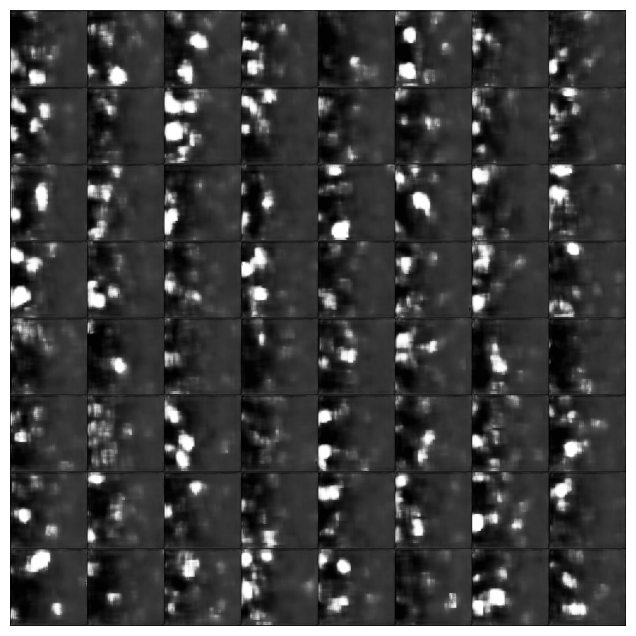

[8/20][1150/1319]	Loss_D: 1.1181	Loss_G: 0.7097	D(x): 0.6778	D(G(z)): 0.4983 / 0.4959
[8/20][1200/1319]	Loss_D: 1.1274	Loss_G: 0.6875	D(x): 0.6889	D(G(z)): 0.5082 / 0.5090


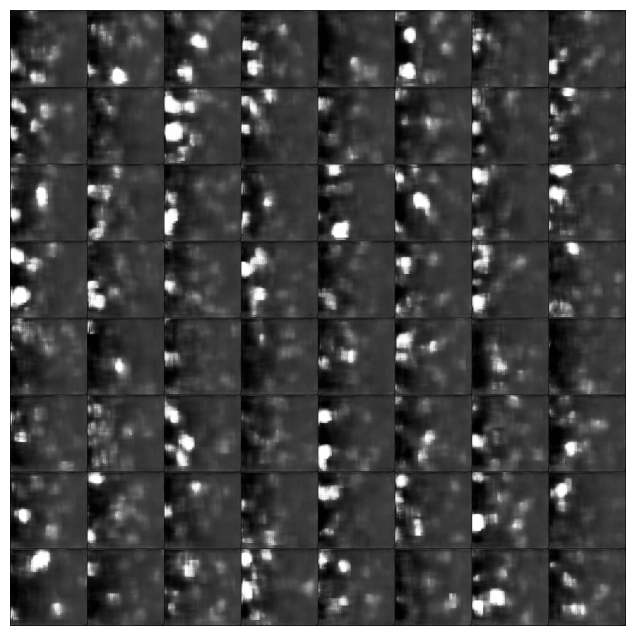

[8/20][1250/1319]	Loss_D: 1.1815	Loss_G: 0.6559	D(x): 0.6675	D(G(z)): 0.5223 / 0.5241
[8/20][1300/1319]	Loss_D: 1.1512	Loss_G: 0.6749	D(x): 0.6763	D(G(z)): 0.5109 / 0.5139


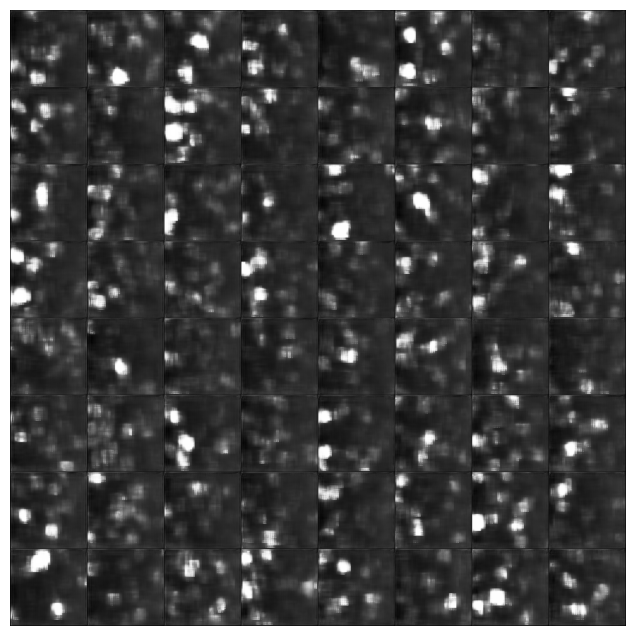

[9/20][0/1319]	Loss_D: 1.2498	Loss_G: 0.6408	D(x): 0.6425	D(G(z)): 0.5305 / 0.5311
[9/20][50/1319]	Loss_D: 1.2075	Loss_G: 0.6582	D(x): 0.6503	D(G(z)): 0.5187 / 0.5225
[9/20][100/1319]	Loss_D: 1.1803	Loss_G: 0.6777	D(x): 0.6558	D(G(z)): 0.5123 / 0.5123
[9/20][150/1319]	Loss_D: 1.1630	Loss_G: 0.6278	D(x): 0.7142	D(G(z)): 0.5406 / 0.5392
[9/20][200/1319]	Loss_D: 1.1175	Loss_G: 0.6551	D(x): 0.7111	D(G(z)): 0.5248 / 0.5235
[9/20][250/1319]	Loss_D: 1.1693	Loss_G: 0.6527	D(x): 0.6870	D(G(z)): 0.5245 / 0.5253
[9/20][300/1319]	Loss_D: 1.1696	Loss_G: 0.6700	D(x): 0.6667	D(G(z)): 0.5151 / 0.5158
[9/20][350/1319]	Loss_D: 1.1629	Loss_G: 0.6578	D(x): 0.6847	D(G(z)): 0.5231 / 0.5227
[9/20][400/1319]	Loss_D: 1.2429	Loss_G: 0.6519	D(x): 0.6371	D(G(z)): 0.5222 / 0.5250
[9/20][450/1319]	Loss_D: 1.1216	Loss_G: 0.6713	D(x): 0.7053	D(G(z)): 0.5170 / 0.5152
[9/20][500/1319]	Loss_D: 1.0878	Loss_G: 0.6671	D(x): 0.7275	D(G(z)): 0.5161 / 0.5177
[9/20][550/1319]	Loss_D: 1.1453	Loss_G: 0.6967	D(x): 0.6675	D(G(z)):

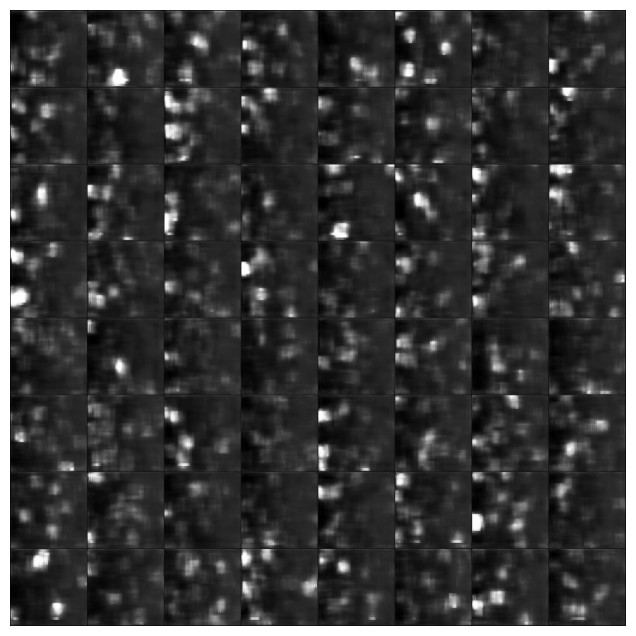

[12/20][50/1319]	Loss_D: 1.0703	Loss_G: 0.7121	D(x): 0.7503	D(G(z)): 0.5023 / 0.5013
[12/20][100/1319]	Loss_D: 1.0889	Loss_G: 0.6960	D(x): 0.7178	D(G(z)): 0.5113 / 0.4988


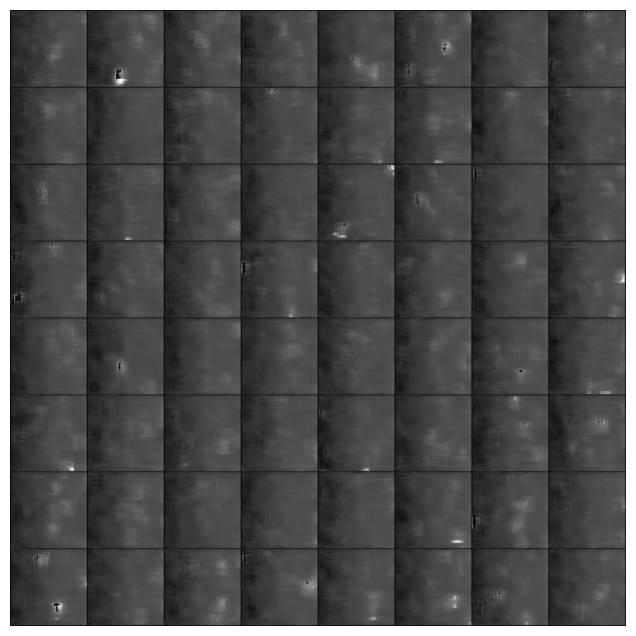

[12/20][150/1319]	Loss_D: 1.0781	Loss_G: 0.7606	D(x): 0.7164	D(G(z)): 0.4827 / 0.4810
[12/20][200/1319]	Loss_D: 1.0612	Loss_G: 0.6296	D(x): 0.7984	D(G(z)): 0.5540 / 0.5355


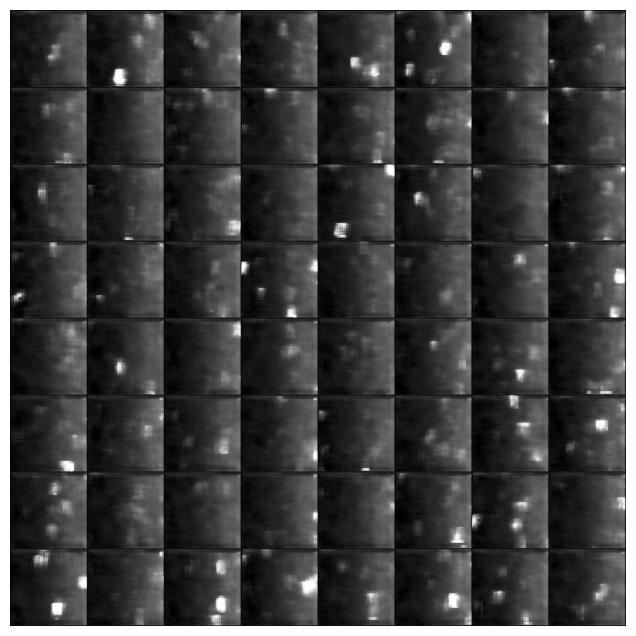

[12/20][250/1319]	Loss_D: 1.1290	Loss_G: 0.7485	D(x): 0.6876	D(G(z)): 0.4935 / 0.4803
[12/20][300/1319]	Loss_D: 1.0361	Loss_G: 0.6933	D(x): 0.7392	D(G(z)): 0.5007 / 0.5022


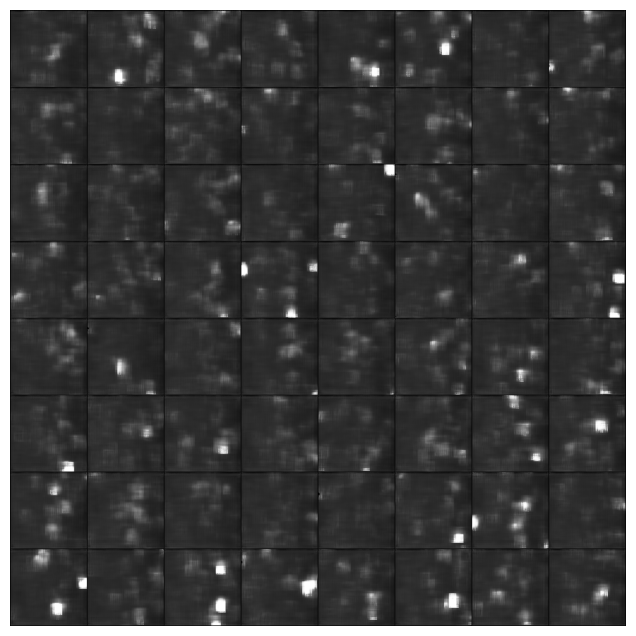

[12/20][350/1319]	Loss_D: 1.0847	Loss_G: 0.6198	D(x): 0.7678	D(G(z)): 0.5398 / 0.5417
[12/20][400/1319]	Loss_D: 1.1054	Loss_G: 0.6793	D(x): 0.7167	D(G(z)): 0.5108 / 0.5117


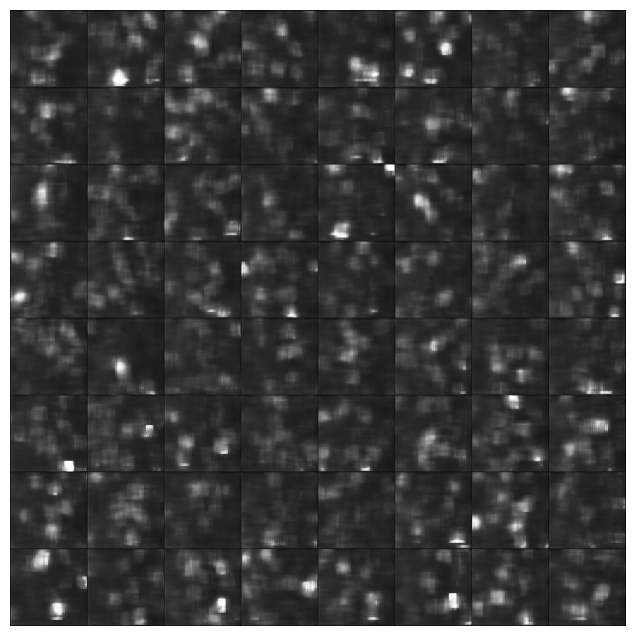

[12/20][450/1319]	Loss_D: 1.1181	Loss_G: 0.7285	D(x): 0.6831	D(G(z)): 0.4875 / 0.4865
[12/20][500/1319]	Loss_D: 1.0624	Loss_G: 0.6962	D(x): 0.7415	D(G(z)): 0.5029 / 0.5032


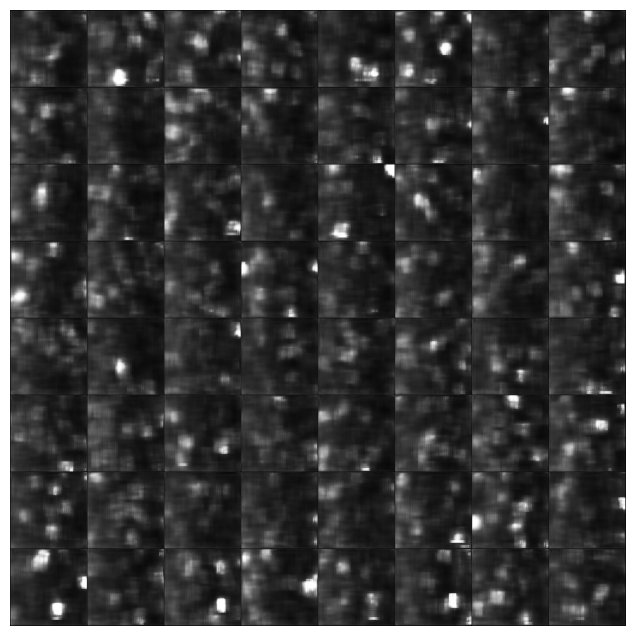

[12/20][550/1319]	Loss_D: 1.1699	Loss_G: 0.6201	D(x): 0.7309	D(G(z)): 0.5468 / 0.5425
[12/20][600/1319]	Loss_D: 1.0563	Loss_G: 0.6992	D(x): 0.7460	D(G(z)): 0.5079 / 0.4996


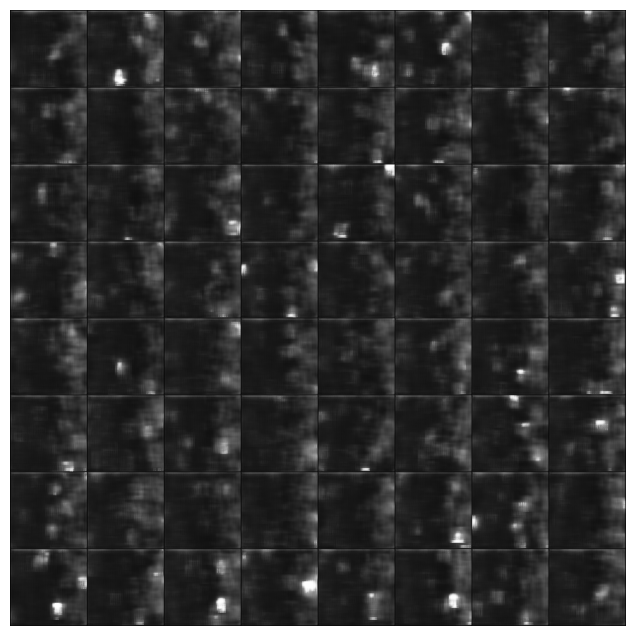

[12/20][650/1319]	Loss_D: 1.1552	Loss_G: 0.6264	D(x): 0.7146	D(G(z)): 0.5372 / 0.5378
[12/20][700/1319]	Loss_D: 1.0495	Loss_G: 0.7128	D(x): 0.7435	D(G(z)): 0.5001 / 0.4971


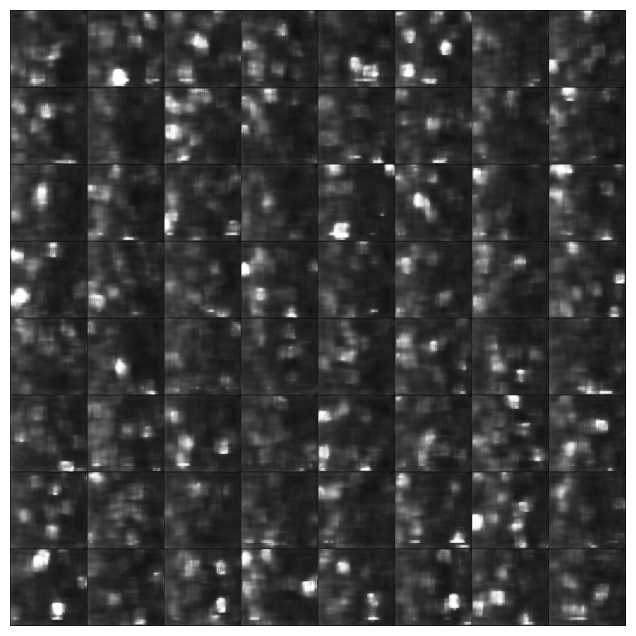

[12/20][750/1319]	Loss_D: 1.0288	Loss_G: 0.7097	D(x): 0.7482	D(G(z)): 0.4949 / 0.4941
[12/20][800/1319]	Loss_D: 1.0513	Loss_G: 0.6604	D(x): 0.7834	D(G(z)): 0.5272 / 0.5226


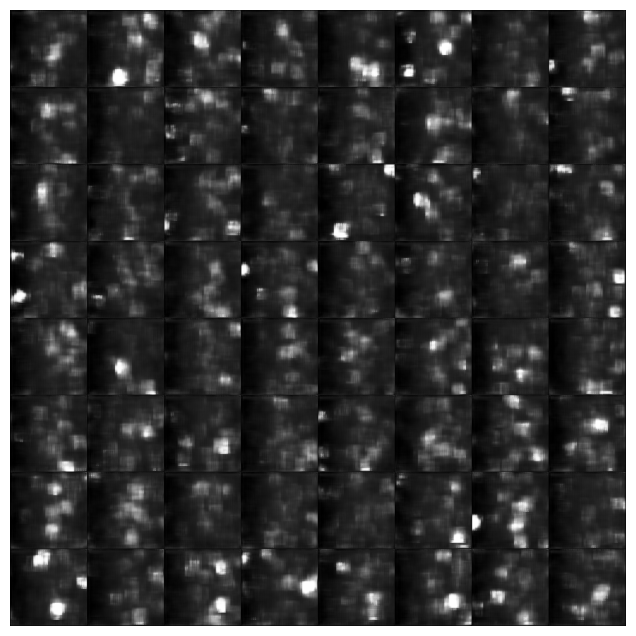

[12/20][850/1319]	Loss_D: 1.1077	Loss_G: 0.6206	D(x): 0.7636	D(G(z)): 0.5476 / 0.5395
[12/20][900/1319]	Loss_D: 1.0515	Loss_G: 0.6371	D(x): 0.8105	D(G(z)): 0.5390 / 0.5399


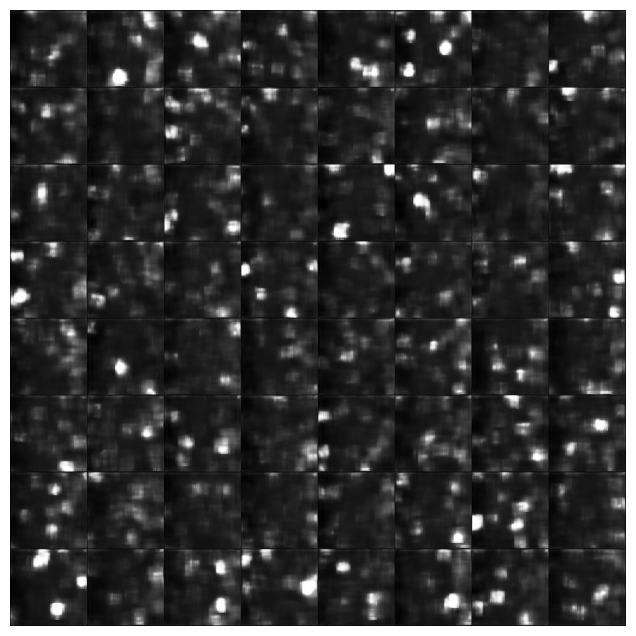

[12/20][950/1319]	Loss_D: 1.1666	Loss_G: 0.6270	D(x): 0.7437	D(G(z)): 0.5510 / 0.5419
[12/20][1000/1319]	Loss_D: 1.0784	Loss_G: 0.7038	D(x): 0.7184	D(G(z)): 0.5029 / 0.4964


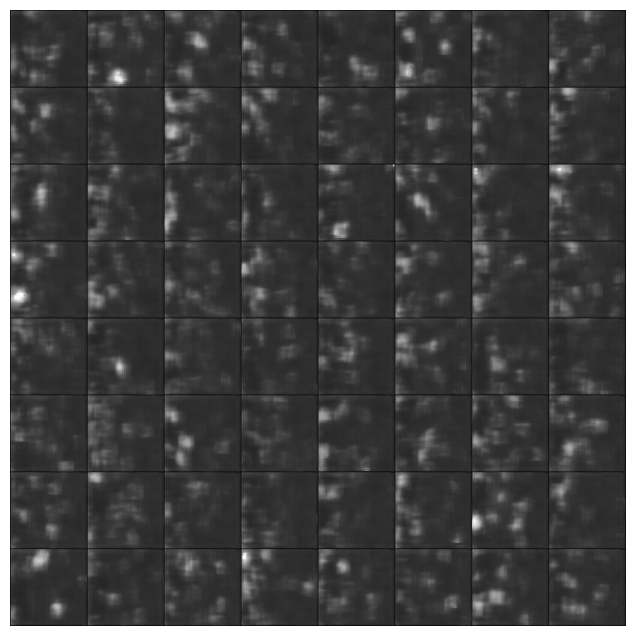

[12/20][1050/1319]	Loss_D: 1.0440	Loss_G: 0.6548	D(x): 0.7910	D(G(z)): 0.5336 / 0.5219
[12/20][1100/1319]	Loss_D: 1.1404	Loss_G: 0.6285	D(x): 0.7551	D(G(z)): 0.5490 / 0.5393


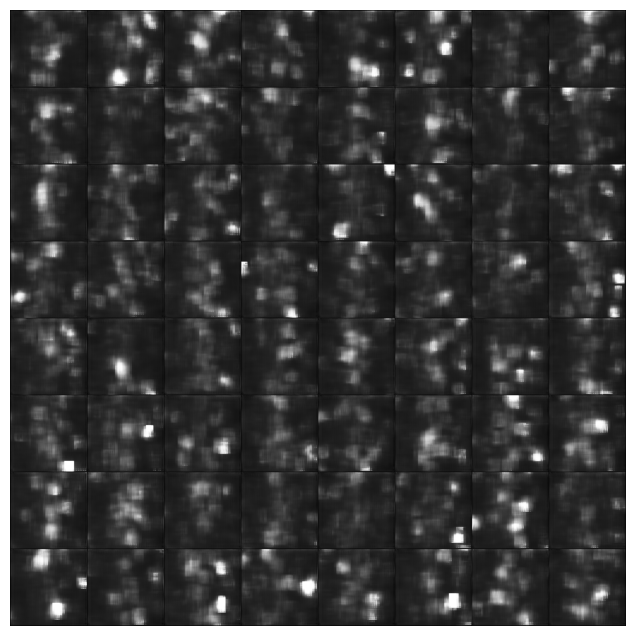

[12/20][1150/1319]	Loss_D: 1.1148	Loss_G: 0.6905	D(x): 0.6996	D(G(z)): 0.4986 / 0.5035
[12/20][1200/1319]	Loss_D: 1.1290	Loss_G: 0.6467	D(x): 0.7384	D(G(z)): 0.5342 / 0.5302


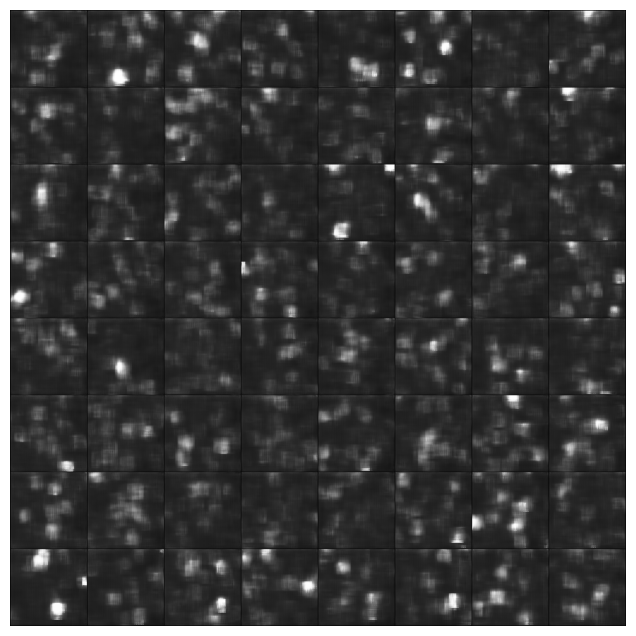

[12/20][1250/1319]	Loss_D: 1.1480	Loss_G: 0.6739	D(x): 0.7171	D(G(z)): 0.5190 / 0.5199
[12/20][1300/1319]	Loss_D: 1.1357	Loss_G: 0.6563	D(x): 0.7060	D(G(z)): 0.5232 / 0.5212


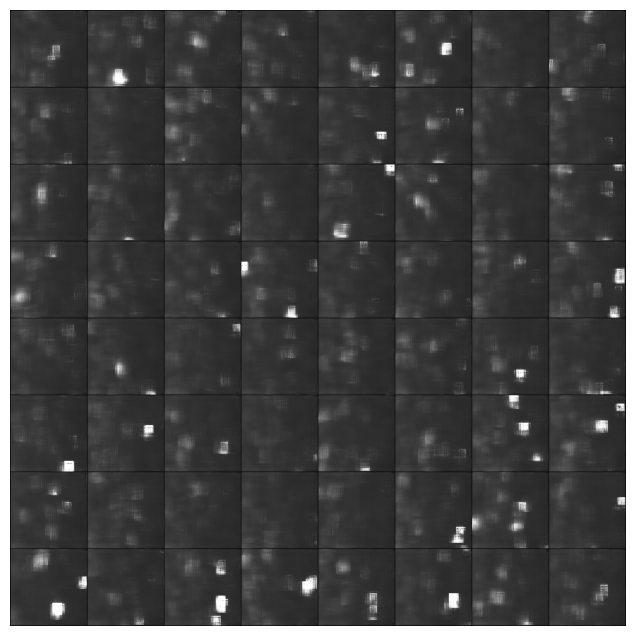

[13/20][0/1319]	Loss_D: 0.9775	Loss_G: 0.7102	D(x): 0.7820	D(G(z)): 0.4974 / 0.4917
[13/20][50/1319]	Loss_D: 1.1296	Loss_G: 0.6280	D(x): 0.8191	D(G(z)): 0.5566 / 0.5528
[13/20][100/1319]	Loss_D: 1.0974	Loss_G: 0.6735	D(x): 0.7408	D(G(z)): 0.5173 / 0.5156
[13/20][150/1319]	Loss_D: 0.9971	Loss_G: 0.6822	D(x): 0.7985	D(G(z)): 0.5174 / 0.5114
[13/20][200/1319]	Loss_D: 1.0505	Loss_G: 0.6773	D(x): 0.7456	D(G(z)): 0.5092 / 0.5111
[13/20][250/1319]	Loss_D: 1.1088	Loss_G: 0.6706	D(x): 0.7719	D(G(z)): 0.5324 / 0.5245
[13/20][300/1319]	Loss_D: 1.0131	Loss_G: 0.6760	D(x): 0.7714	D(G(z)): 0.5089 / 0.5121
[13/20][350/1319]	Loss_D: 1.1631	Loss_G: 0.6220	D(x): 0.7606	D(G(z)): 0.5540 / 0.5491
[13/20][400/1319]	Loss_D: 1.0982	Loss_G: 0.6866	D(x): 0.7177	D(G(z)): 0.5027 / 0.5035
[13/20][450/1319]	Loss_D: 1.0980	Loss_G: 0.5788	D(x): 0.8464	D(G(z)): 0.5759 / 0.5730
[13/20][500/1319]	Loss_D: 1.0089	Loss_G: 0.7186	D(x): 0.7566	D(G(z)): 0.4895 / 0.4928
[13/20][550/1319]	Loss_D: 1.0355	Loss_G: 0.6797	D(x): 0.7

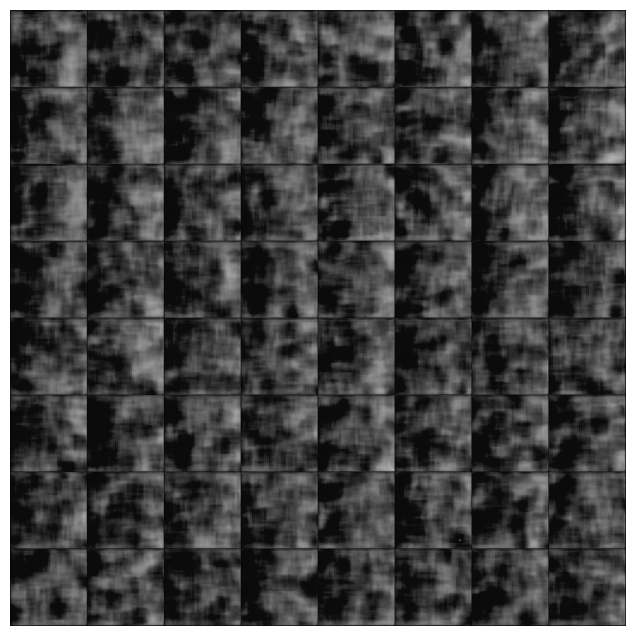

[16/20][50/1319]	Loss_D: 1.0565	Loss_G: 0.6745	D(x): 0.7710	D(G(z)): 0.5126 / 0.5171
[16/20][100/1319]	Loss_D: 0.9969	Loss_G: 0.6401	D(x): 0.8242	D(G(z)): 0.5245 / 0.5318


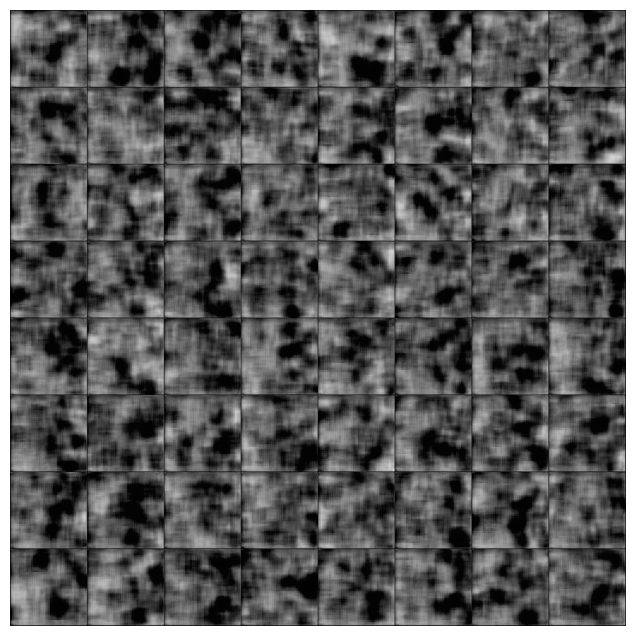

[16/20][150/1319]	Loss_D: 1.0282	Loss_G: 0.6762	D(x): 0.7917	D(G(z)): 0.5212 / 0.5143
[16/20][200/1319]	Loss_D: 0.9826	Loss_G: 0.6908	D(x): 0.8029	D(G(z)): 0.5094 / 0.5059


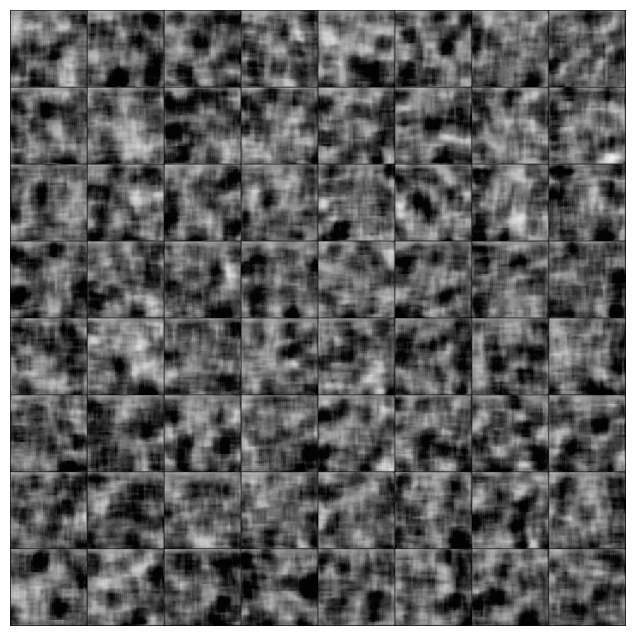

[16/20][250/1319]	Loss_D: 1.0217	Loss_G: 0.6723	D(x): 0.7937	D(G(z)): 0.5183 / 0.5183
[16/20][300/1319]	Loss_D: 0.9718	Loss_G: 0.6430	D(x): 0.8459	D(G(z)): 0.5319 / 0.5317


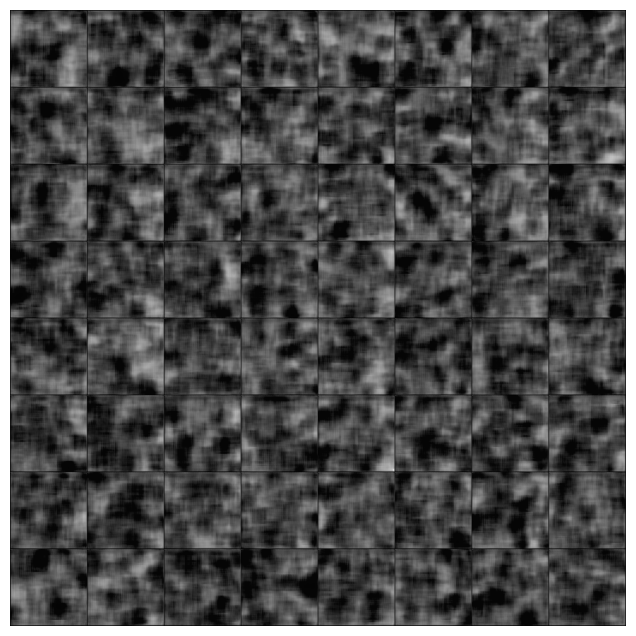

[16/20][350/1319]	Loss_D: 1.0596	Loss_G: 0.6677	D(x): 0.7844	D(G(z)): 0.5221 / 0.5219
[16/20][400/1319]	Loss_D: 1.0142	Loss_G: 0.7446	D(x): 0.7492	D(G(z)): 0.4880 / 0.4761


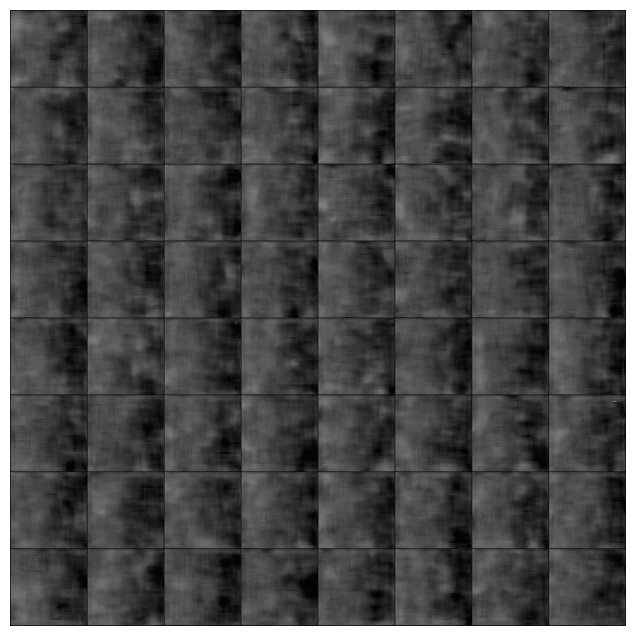

[16/20][450/1319]	Loss_D: 1.0280	Loss_G: 0.6495	D(x): 0.7909	D(G(z)): 0.5286 / 0.5232
[16/20][500/1319]	Loss_D: 0.9346	Loss_G: 0.7747	D(x): 0.8033	D(G(z)): 0.4821 / 0.4696


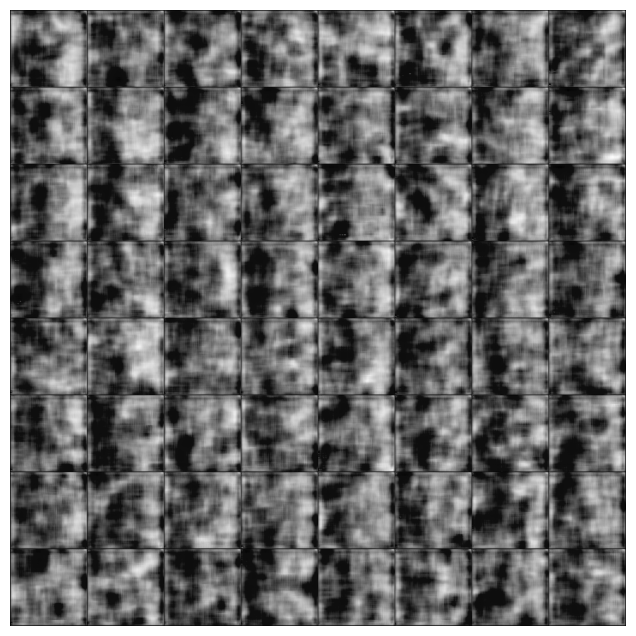

[16/20][550/1319]	Loss_D: 1.0804	Loss_G: 0.7462	D(x): 0.7286	D(G(z)): 0.4883 / 0.4843
[16/20][600/1319]	Loss_D: 0.9672	Loss_G: 0.7247	D(x): 0.7992	D(G(z)): 0.4965 / 0.4894


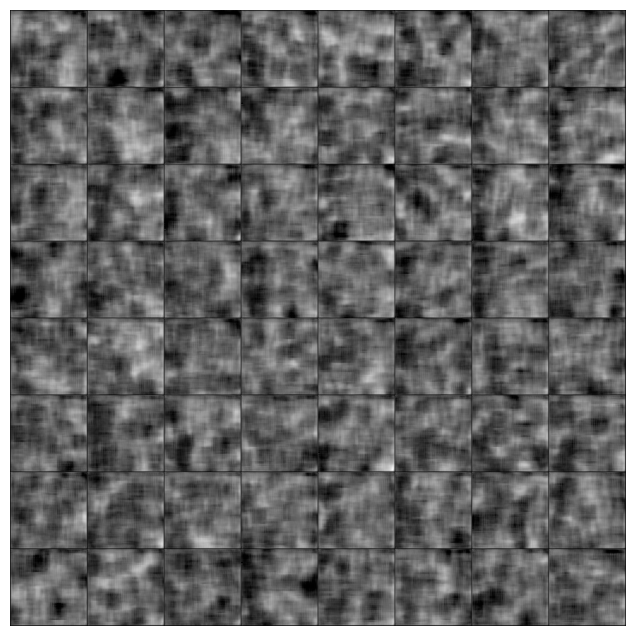

[16/20][650/1319]	Loss_D: 1.0443	Loss_G: 0.6735	D(x): 0.7600	D(G(z)): 0.5087 / 0.5159
[16/20][700/1319]	Loss_D: 1.0880	Loss_G: 0.6608	D(x): 0.7361	D(G(z)): 0.5141 / 0.5217


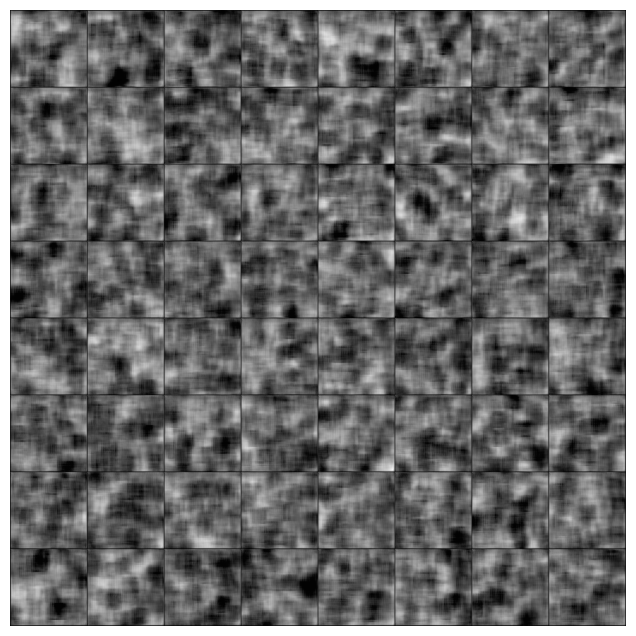

[16/20][750/1319]	Loss_D: 1.0507	Loss_G: 0.6684	D(x): 0.7701	D(G(z)): 0.5126 / 0.5181
[16/20][800/1319]	Loss_D: 0.9684	Loss_G: 0.6841	D(x): 0.8065	D(G(z)): 0.5080 / 0.5087


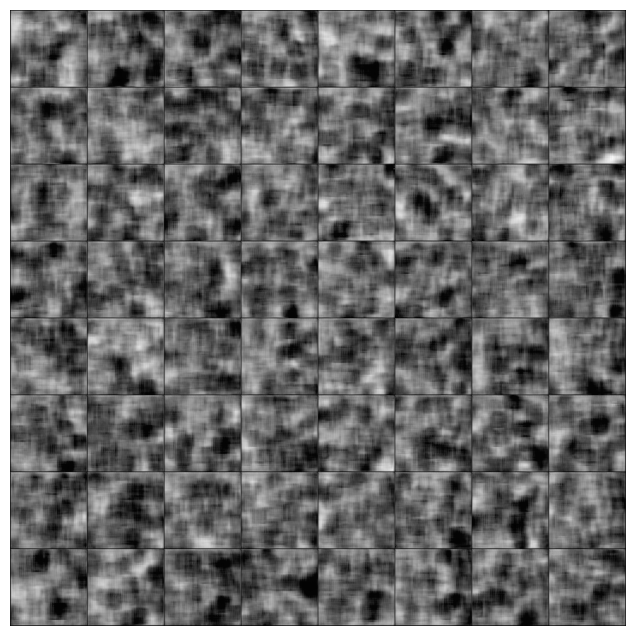

[16/20][850/1319]	Loss_D: 0.9421	Loss_G: 0.7489	D(x): 0.7948	D(G(z)): 0.4831 / 0.4749
[16/20][900/1319]	Loss_D: 1.1642	Loss_G: 0.6242	D(x): 0.7215	D(G(z)): 0.5371 / 0.5437


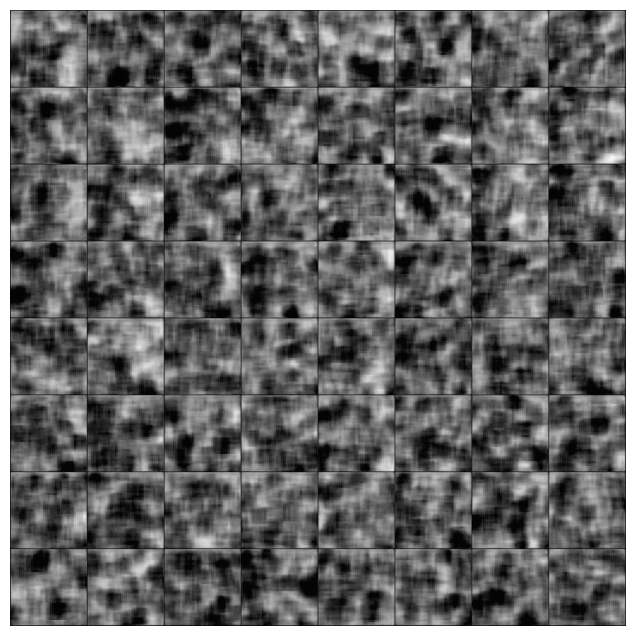

[16/20][950/1319]	Loss_D: 0.9926	Loss_G: 0.7377	D(x): 0.7715	D(G(z)): 0.4936 / 0.4802
[16/20][1000/1319]	Loss_D: 0.9471	Loss_G: 0.7152	D(x): 0.8244	D(G(z)): 0.4984 / 0.4955


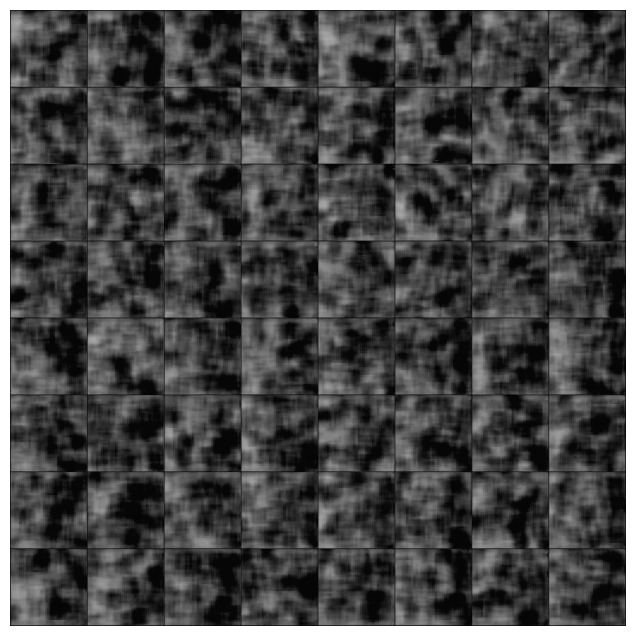

[16/20][1050/1319]	Loss_D: 0.9738	Loss_G: 0.7088	D(x): 0.7808	D(G(z)): 0.4913 / 0.4967
[16/20][1100/1319]	Loss_D: 1.0019	Loss_G: 0.6984	D(x): 0.7981	D(G(z)): 0.5117 / 0.5035


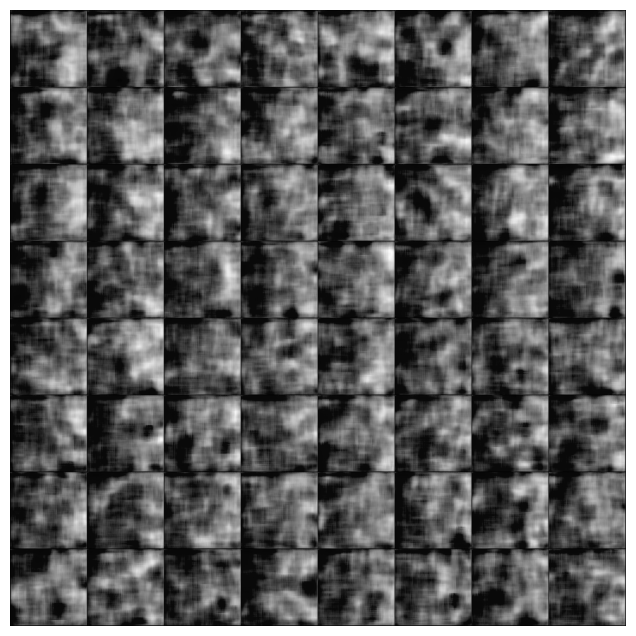

[16/20][1150/1319]	Loss_D: 0.9972	Loss_G: 0.6583	D(x): 0.8285	D(G(z)): 0.5312 / 0.5230
[16/20][1200/1319]	Loss_D: 0.9586	Loss_G: 0.7081	D(x): 0.8059	D(G(z)): 0.5007 / 0.4980


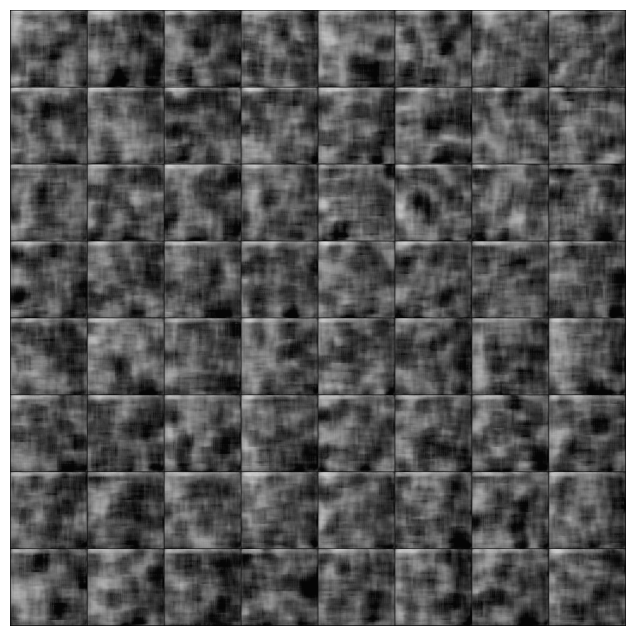

[16/20][1250/1319]	Loss_D: 0.9739	Loss_G: 0.6704	D(x): 0.8340	D(G(z)): 0.5219 / 0.5186
[16/20][1300/1319]	Loss_D: 0.9646	Loss_G: 0.7542	D(x): 0.7742	D(G(z)): 0.4664 / 0.4713


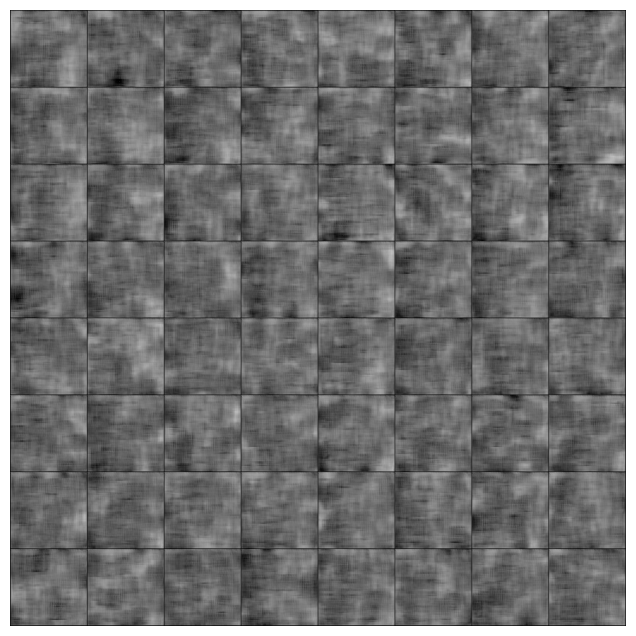

[17/20][0/1319]	Loss_D: 0.9387	Loss_G: 0.6673	D(x): 0.8427	D(G(z)): 0.5224 / 0.5156
[17/20][50/1319]	Loss_D: 1.0289	Loss_G: 0.6230	D(x): 0.8206	D(G(z)): 0.5448 / 0.5414
[17/20][100/1319]	Loss_D: 0.9861	Loss_G: 0.7151	D(x): 0.7639	D(G(z)): 0.4885 / 0.4910
[17/20][150/1319]	Loss_D: 0.9946	Loss_G: 0.6368	D(x): 0.8448	D(G(z)): 0.5414 / 0.5357
[17/20][200/1319]	Loss_D: 0.9383	Loss_G: 0.6802	D(x): 0.8532	D(G(z)): 0.5241 / 0.5097
[17/20][250/1319]	Loss_D: 1.0340	Loss_G: 0.5953	D(x): 0.8603	D(G(z)): 0.5659 / 0.5591
[17/20][300/1319]	Loss_D: 1.0382	Loss_G: 0.6526	D(x): 0.8373	D(G(z)): 0.5458 / 0.5296
[17/20][350/1319]	Loss_D: 1.0235	Loss_G: 0.6911	D(x): 0.7781	D(G(z)): 0.5081 / 0.5072
[17/20][400/1319]	Loss_D: 0.9561	Loss_G: 0.7000	D(x): 0.8023	D(G(z)): 0.5011 / 0.4972
[17/20][450/1319]	Loss_D: 1.0761	Loss_G: 0.6332	D(x): 0.7982	D(G(z)): 0.5423 / 0.5386
[17/20][500/1319]	Loss_D: 0.8973	Loss_G: 0.7076	D(x): 0.8498	D(G(z)): 0.5041 / 0.4967
[17/20][550/1319]	Loss_D: 0.9960	Loss_G: 0.7330	D(x): 0.7

In [28]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")

for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
         ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        
        ##train with all reals
        netD.zero_grad()
        #setup batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,1), real_label, dtype=torch.float, device = device)
        
        #fwd pass thru D
        output = netD(real_cpu)
        #calc loss on real
        errD_real = criterion(output, label)
        #calc grads for D
        errD_real.backward()
        D_x = output.mean().item()
        
        ##train with all fakes
        #gen batch of latent
        noise = torch.randn(b_size, 256*256,1,1, device = device)
        #generate fake batch by G
#         print(noise.shape)
        fake = netG(noise)
        label.fill_(fake_label)
        #classify all fakes with D
        output = netD(fake.detach())
        #calc D's loss
        errD_fake = criterion(output, label)
        #calc gradients accumulates with prev grads
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        #compute errD as sum of fake and real
        errD = errD_real + errD_fake
        
        #update D
        
        optimizerD.step()
        
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
        label.fill_(real_label)# fake labels are real for generator cost
        output = netD(fake)
#         print(output)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        if i%50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        if (epoch % 4 == 0) and (i%100 == 0):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            fig = plt.figure(figsize=(8,8))
            plt.axis("off")
            ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
            plt.show()
            
            img_list = []
        
        if(epoch%5 == 0) and (i % 600 == 0):
            # Additional information
            PATH = f"/kaggle/working/checkpoints/{epoch}_{i}_GAN.pt"
            torch.save({
                
                'Gen_state_dict': netG.state_dict(),
                'Disc_state_dict': netD.state_dict(),
                'optimizerG_state_dict': optimizerG.state_dict(),
                'optimizerD_state_dict': optimizerD.state_dict(),
            }, PATH)

        iters += 1

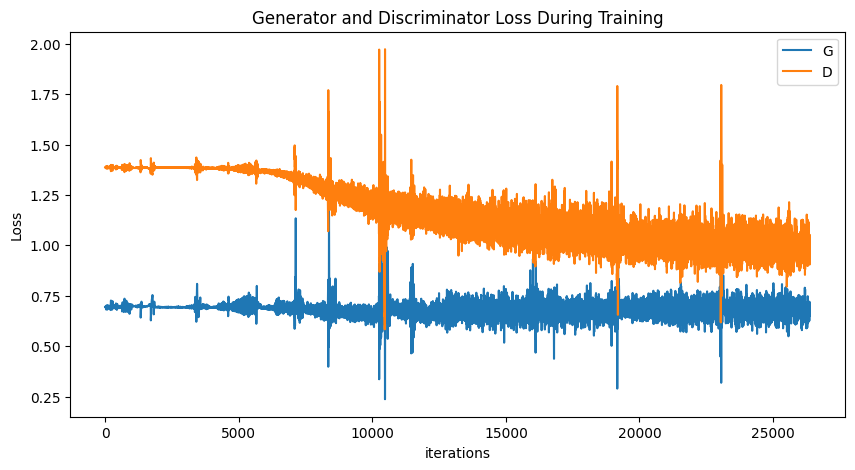

In [29]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [30]:
!zip -r checkpoints.zip /kaggle/working/checkpoints

  adding: kaggle/working/checkpoints/ (stored 0%)
  adding: kaggle/working/checkpoints/5_600_GAN.pt (deflated 9%)
  adding: kaggle/working/checkpoints/10_600_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/5_0_GAN.pt (deflated 9%)
  adding: kaggle/working/checkpoints/10_1200_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/0_600_GAN.pt (deflated 9%)
  adding: kaggle/working/checkpoints/5_1200_GAN.pt (deflated 9%)
  adding: kaggle/working/checkpoints/0_0_GAN.pt (deflated 9%)
  adding: kaggle/working/checkpoints/15_600_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/15_0_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/0_1200_GAN.pt (deflated 9%)
  adding: kaggle/working/checkpoints/15_1200_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/10_0_GAN.pt (deflated 8%)
